In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import cv2
import csv
import time
import tensorflow as tf
import keras
import glob
from PIL import Image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Activation,Concatenate
from tensorflow.keras.layers import BatchNormalization, LeakyReLU, Flatten, Dense, Dropout, UpSampling2D
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.figure import Figure
from mpl_toolkits.axes_grid1 import ImageGrid
from pprint import pprint
%matplotlib inline
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.callbacks import EarlyStopping
import logging
logging.getLogger('tensorflow').disabled = True
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

# Image Augmentation Functions

In [2]:
from scipy.ndimage import binary_erosion
import random
import math

def flip_horizontal(img):
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    # print("mask.shape", tf.shape(mask), mask.shape)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    # print("mask.shape", tf.shape(mask), mask.shape)
    #print("mask.dtype", mask.dtype)
    #mask = tf.cast(mask, tf.bool)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1]) #mshape[2], 1])
    mshape = tf.shape(mask)
    flipped = tf.image.flip_left_right(img)
    mask = tf.image.flip_left_right(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    kernel = tf.zeros([3, 3, mshape[2]])#mshape[3]]) 
    mask = tf.reshape(mask, [1, mshape[0], mshape[1], 1])
    mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    mask = tf.math.greater(mask, 0.0)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1])
    
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    mat = [[1.0,0.0,0.0],[0.0,-1.0,0.0],[0.0,0.0,1.0]]
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    # print("flipped.shape", flipped.shape)
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
    return flipped


def myrotate(img):
    return tf.keras.preprocessing.image.apply_affine_transform(img, theta=angle, zx=zoom, zy=zoom)


def random_rotate(img):
    #res = []
    res = tf.TensorArray(tf.float32, size=0, dynamic_size=True)
    ishape = tf.shape(img)
    for i in range(ishape[0]):
        global angle, zoom
        angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
        zoom = 1.0 + (random.random()-0.5)*0.2
        # print("angle", angle)
        background = tf.constant([-1.0, -1.0, -1.0])
        mask = tf.math.greater(img[i, :,:,:], background)
        tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
        mask = tf.math.logical_or(mask[:,:,2], tmp)
        mshape = tf.shape(mask)
        mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
        img_i = img[i, :,:,:]
        # print("img_i.shape", tf.shape(img_i))
        img_i = tf.transpose(img_i, [2, 0, 1])
        #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
        #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.py_function(func=myrotate, inp=[img_i], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.transpose(flipped, [1, 2, 0])
        mask = tf.transpose(mask, [2,0,1])
        mshape = tf.shape(mask)
        mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
        #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
        mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
        mask = tf.math.greater(mask, 0.0)
        mask = tf.transpose(mask, [1,2,0])
        #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
        #kernel = tf.zeros([3, 3, mask.shape[2]]) 
        #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
        #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
        #mask = tf.math.greater(mask, 0.0)
        #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
        # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
        # So left-right flip means negating the green channel
        angle = math.pi*angle/180.0
        mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
        #print("flipped.shape", flipped.shape)
        mult = tf.linalg.matvec(mat, flipped)
        fshape = tf.shape(flipped)
    
        flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        #res.append(flipped)
        res = res.write(res.size(), flipped)
    flipped = res.stack()#tf.stack(res)
    # print("flipped.shape", tf.shape(flipped))
    return flipped

def random_rotate_single(img):
    global angle, zoom
    angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
    zoom = 1.0 + (random.random()-0.5)*0.2
    # # print("angle", angle)
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
    # print("img.shape", tf.shape(img))
    img = tf.transpose(img, [2, 0, 1])
    #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
    #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.py_function(func=myrotate, inp=[img], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.transpose(flipped, [1, 2, 0])
    mask = tf.transpose(mask, [2,0,1])
    mshape = tf.shape(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
    mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
    mask = tf.math.greater(mask, 0.0)
    mask = tf.transpose(mask, [1,2,0])
    #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
    #kernel = tf.zeros([3, 3, mask.shape[2]]) 
    #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
    #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    #mask = tf.math.greater(mask, 0.0)
    #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    angle = math.pi*angle/180.0
    mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
    #print("flipped.shape", flipped.shape)
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        
    return flipped
#flipped_dataset = train_dataset.map(flip_horizontal)

def applyFlip(ds):
  return train_dataset.map(flip_horizontal)

def applyRotate(ds):
  return train_dataset.map(random_rotate_single)

def flipRotate(img):
  img = flip_horizontal(img)
  img = random_rotate_single(img)
  return img
  
def applyFlipRotate(ds):
  return train_dataset.map(flipRotate)
  
# for images in train_dataset.take(1):
#     flip = flip_horizontal(images)
#     print("images.shape", images.shape)
    
#     flip = random_rotate(flip)
#     print("flip.shape", flip.shape)
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), flip):
#         ax.imshow((img+1)/2)
#         ax.axis('off')
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), images):
#         ax.imshow((img+1)/2)
#         ax.axis('off')

# plt.suptitle('Examples Of Six Training Images from flipped dataset', fontsize='xx-large',fontweight='heavy')
# plt.show()

# Preparation and presentation of datasets

### Acquire and Preprocess Dataset

In [3]:
BATCH_SIZE = 15

img_dir = '../dataset/sfs-net/'

train_files = glob.glob(img_dir + 'train/0003/*normal*.png')
test_files = glob.glob(img_dir + 'test/0603/*normal*.png')

def preprocess(images):
    images = tf.image.resize(images, [256, 256])
    images = tf.cast(images, tf.float32)
    images = (images - 127.5) / 127.5 # [-1, 1]
    return images


def load_and_preprocess_image(file_path):
    # print("file_path", file_path)
    # Load the image from file
    image = tf.io.read_file(file_path)
    # Decode the image to a tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Preprocess the image
    image = preprocess(image)
    return image


def normalise(images):
    images,images_norm = tf.linalg.normalize(images, axis=2) #Normalise the input data
    return images


train_dataset = tf.data.Dataset.from_tensor_slices(train_files)
test_dataset = tf.data.Dataset.from_tensor_slices(test_files)

print("Original training dataset size:", len(train_files))
print("Original testing dataset size:", len(test_files))

train_dataset = train_dataset.map(load_and_preprocess_image)
test_dataset = test_dataset.map(load_and_preprocess_image)
img = train_dataset.take(1)
print("Original - img.element_spec", img.element_spec)
train_dataset_width = int(img.element_spec.shape[0])
train_dataset_height = int(img.element_spec.shape[1])

# augmentations
flipped_dataset = train_dataset.map(flip_horizontal)#apply(applyFlip)#
rotated_dataset = train_dataset.map(random_rotate_single)#apply(applyRotate)#
flipped_rotated = train_dataset.map(flipRotate)#apply(applyFlipRotate)#apply(applyFlip).apply(applyRotate)

train_dataset = train_dataset.concatenate(rotated_dataset)
train_dataset = train_dataset.concatenate(flipped_dataset)
train_dataset = train_dataset.concatenate(flipped_rotated)

#train_dataset.save(img_dir + 'train/augmented/')
#train_dataset = tf.data.Dataset.load(img_dir + 'train/augmented/')

train_dataset = train_dataset.map(normalise)
test_dataset = test_dataset.map(normalise)

print("Augmented training dataset size:", len(list(train_dataset)))
print("Augmented testing dataset size:", len(list(test_dataset)))

train_dataset = train_dataset.shuffle(len(train_files)*2).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

print("Total number of batches in training dataset:", len(list(train_dataset)))
print("Total number of batches in testing dataset:", len(list(test_dataset)))
print("train dataset: ", tf.data.DatasetSpec.from_value(train_dataset))
print("test dataset: ", tf.data.DatasetSpec.from_value(test_dataset))

train_dataset = train_dataset.prefetch(100).cache()

Original training dataset size: 300
Original testing dataset size: 105
Original - img.element_spec TensorSpec(shape=(256, 256, 3), dtype=tf.float32, name=None)
Augmented training dataset size: 1200
Augmented testing dataset size: 105
Total number of batches in training dataset: 80
Total number of batches in testing dataset: 7
train dataset:  DatasetSpec(TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None), TensorShape([]))
test dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))


### Show some images on the train dataset

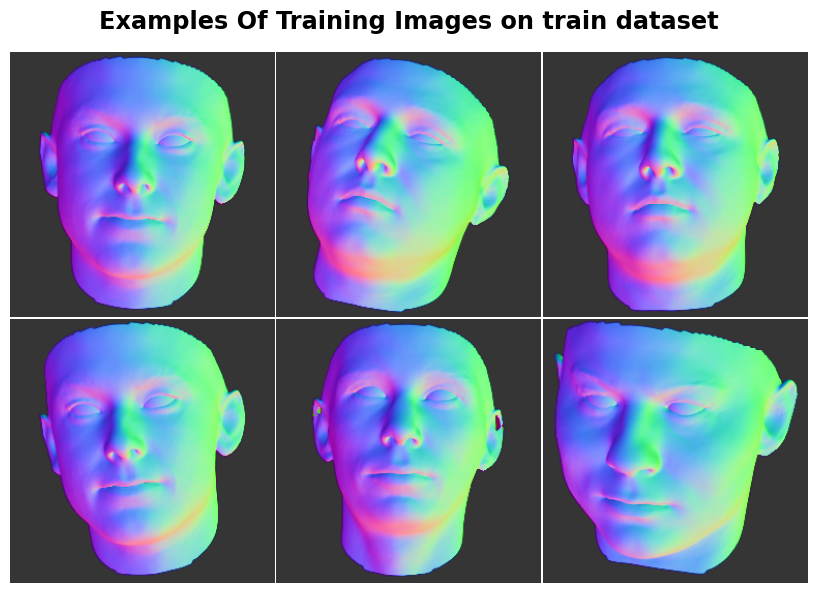

In [4]:
for images in train_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Training Images on train dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Show some images on the test dataset

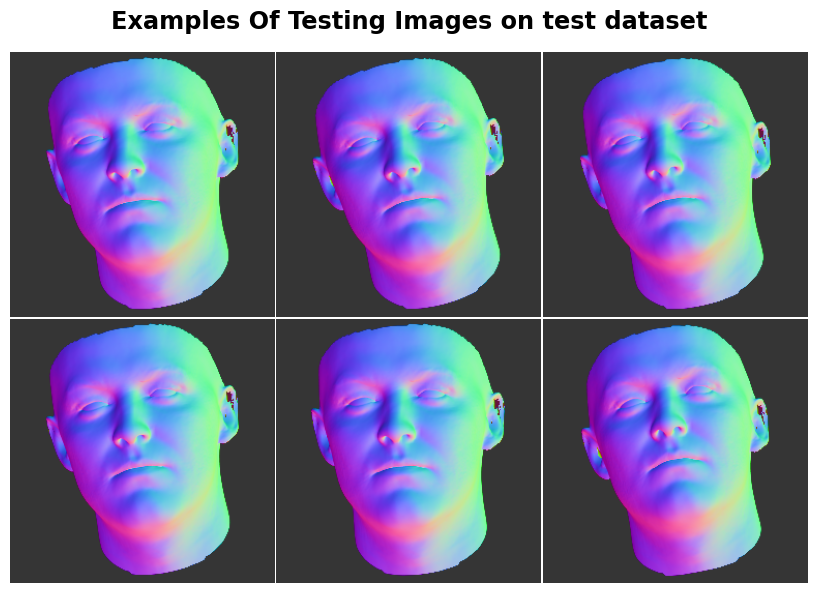

In [5]:
for images in test_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Testing Images on test dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

# Mask Code Set

### Generate Irregular Mask (batch size)

In [6]:
def mask_irregular(batch_size, mask_width, mask_height):
    size = int(round((mask_width + mask_height) * 0.03))
    mask = np.zeros((batch_size, mask_width, mask_height, 1))
    
    for i in range(batch_size):
        # Create small blobs randomly distributed
        num_blobs = np.random.randint(20, 50)  # increase the number of blobs
        for _ in range(num_blobs):
            blob_size = np.random.randint(min(mask_width, mask_height) // 40, min(mask_width, mask_height) // 20)  # decrease the size of blobs
            x = np.random.randint(0, mask_width)
            y = np.random.randint(0, mask_height)
            cv2.circle(mask[i], (x, y), blob_size, (1,1,1), -1)
    
    return np.float32(((1 - mask)*2) - 1) # [-1, 1]

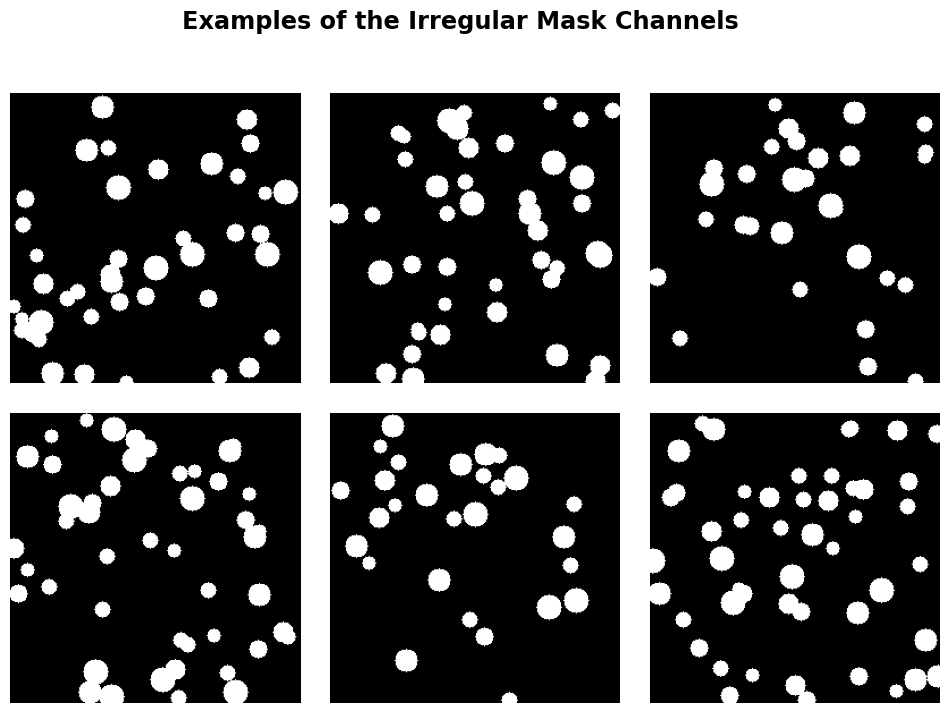

In [7]:
irregular_mask_examples = mask_irregular(6, train_dataset_width, train_dataset_height)
for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.show()

### Generate the masked imgs (batch size)

In [8]:
def masked_imgs(raw_imgs, mask_channels):
    
    raw_imgs = (raw_imgs + 1.0) / 2.0 # [0, 1]
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    
    # masked_images = np.multiply(raw_imgs, mask_channels)
    masked_images = tf.multiply(raw_imgs, mask_channels)  # 使用 tf.multiply 替代 np.multiply
    
    masked_images = (masked_images * 2.0) - 1.0 # [-1, 1]
    
#     masked_images[:][masked_images[:] == 0] = 1. # Set the white mask
    
    return masked_images

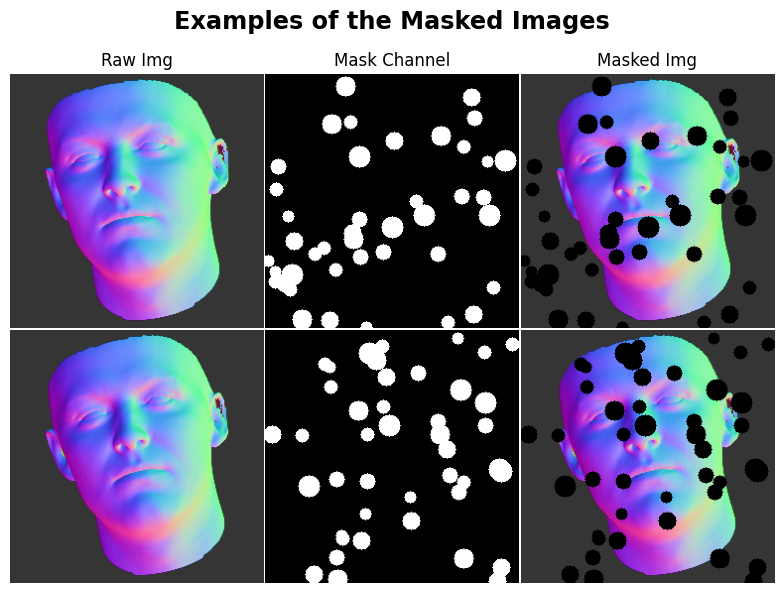

In [9]:
for images_batch in test_dataset.take(1):
    raw_images_examples = images_batch[:2]

irregular_mask_examples = irregular_mask_examples[:2]
masked_images_examples = masked_imgs(raw_images_examples, irregular_mask_examples)

grid = ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3))

for i in range(2):
    ax = grid[i*3]
    ax.imshow((raw_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Raw Img')
    
    ax = grid[i*3+1]
    ax.imshow((irregular_mask_examples[i]+1)/2, cmap='binary')
    ax.axis('off')
    if i == 0:
        ax.set_title('Mask Channel')
    
    ax = grid[i*3+2]
    ax.imshow((masked_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Masked Img')
    
plt.suptitle('Examples of the Masked Images', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the pred only masked region imgs (batch size)

In [10]:
def only_masked_region_pred_imgs(mask_channels, masked_imgs, pred_imgs):
    
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    masked_imgs = (masked_imgs + 1.0) / 2.0 # [0, 1]
    pred_imgs = (pred_imgs + 1.0) / 2.0 # [0, 1]
    
    masked_region_pred_imgs = masked_imgs + pred_imgs * (1.0 - mask_channels)
    
    masked_region_pred_imgs = (masked_region_pred_imgs * 2.0) - 1.0 # [-1, 1]
    
    return masked_region_pred_imgs

# Painting Function

In [11]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3)), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path)   
    plt.show()

In [12]:
def plot_loss_metric(train_loss, train_metric, test_loss, test_metric, title, metric, start=0):
    x_values = range(start, start + len(train_loss))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plotting the training set
    ax_train_loss = ax1
    ax_train_metric = ax1.twinx()
    ax_train_loss.plot(x_values, train_loss, color='tab:red')
    ax_train_metric.plot(x_values, train_metric, color='tab:blue')

    ax_train_loss.set_xlabel('Epochs')
    ax_train_loss.set_ylabel('Loss', color='tab:red')
    ax_train_metric.set_ylabel(metric, color='tab:blue')

    ax_train_loss.tick_params(axis='y', labelcolor='tab:red')
    ax_train_metric.tick_params(axis='y', labelcolor='tab:blue')

    ax1.set_title('Train - ' + title)

    # Plotting the test set
    ax_test_loss = ax2
    ax_test_metric = ax2.twinx()
    ax_test_loss.plot(x_values, test_loss, color='tab:green')
    ax_test_metric.plot(x_values, test_metric, color='tab:purple')

    ax_test_loss.set_xlabel('Epochs')
    ax_test_loss.set_ylabel('Loss', color='tab:green')
    ax_test_metric.set_ylabel(metric, color='tab:purple')

    ax_test_loss.tick_params(axis='y', labelcolor='tab:green')
    ax_test_metric.tick_params(axis='y', labelcolor='tab:purple')

    ax2.set_title('Test - ' + title)

    plt.tight_layout()
    plt.show()

# Model Definition Code Set

### Define the loss

In [13]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
# Cosine Similarity
cosine_loss = tf.keras.losses.CosineSimilarity(axis=3)

### Generator (encoder-decoder network)

In [14]:
class UnitNormalize(tf.keras.layers.Layer):
    def __init__(self):
        super(UnitNormalize, self).__init__()

    def call(self, inputs):
        return tf.math.l2_normalize(inputs, axis=2, epsilon=1e-6)

In [15]:
def generator_model():
    
    masked_image = tf.keras.layers.Input(shape=((256, 256, 3)))
    mask = tf.keras.layers.Input(shape=((256, 256, 1)))
    maskedImage_mask = tf.keras.layers.concatenate([masked_image, mask])
    
    # Encoder - Input a masked image and mask
    
    # (256, 256, 4) -> (128, 128, 64) 
    x = Conv2D(64, kernel_size=4, strides=2, padding="same")(maskedImage_mask)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (128, 128, 64) -> (64, 64, 128) 
    x = Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (64, 64, 128) -> (32, 32, 256) 
    x = Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (32, 32, 256) -> (16, 16, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (16, 16, 512) -> (8, 8, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (8, 8, 512) -> (4, 4, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (4, 4, 512) -> (2, 2, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)

    # (2, 2, 512) -> (1, 1, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # Decoder
    
    # (1, 1, 512) -> (2, 2, 512)
    x = Conv2DTranspose(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (2, 2, 512) -> (4, 4, 512)
    x = Conv2DTranspose(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (4, 4, 512) -> (8, 8, 256)
    x = Conv2DTranspose(256, kernel_size=4,strides=2,padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (8, 8, 256) -> (16, 16, 128)
    x = Conv2DTranspose(128, kernel_size=4,strides=2,padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (16, 16, 128) -> (32, 32, 64)
    x = Conv2DTranspose(64, kernel_size=4,strides=2,padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (32, 32, 64) -> (64, 64, 32)
    x = Conv2DTranspose(32, kernel_size=4,strides=2,padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (64, 64, 32) -> (128, 128, 16)
    x = Conv2DTranspose(16, kernel_size=4,strides=2,padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    
    # (128, 128, 16) -> (256, 256, 3)
    x = Conv2DTranspose(3, kernel_size=4,strides=2,padding="same")(x)
    
    x = Activation('tanh')(x) # [-1, 1]
    output = UnitNormalize()(x)
    
    model = tf.keras.Model(inputs=[masked_image, mask], outputs=output)

    return model

In [16]:
def generator_loss(fake_output, target_images, generated_images, 
                   lambda_reconstruction = 999, lambda_adversarial=1):
    
    reconstruction_loss = 1 + cosine_loss(target_images, generated_images)
    
    adversarial_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    
    total_loss = lambda_reconstruction * reconstruction_loss + lambda_adversarial * adversarial_loss
    
    return total_loss

In [17]:
def generator_ssim(target_images, generated_images):
    ssim = tf.image.ssim(target_images, generated_images, max_val=2.0)
    ssim = tf.reduce_mean(ssim)
    return ssim

In [18]:
def generator_psnr(target_images, generated_images):
    psnr = tf.image.psnr(target_images, generated_images, max_val=2.0)
    psnr = tf.reduce_mean(psnr)
    return psnr

In [19]:
generator = generator_model()
generator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

### Discriminator

In [20]:
def discriminator_model():
    
    image = tf.keras.layers.Input(shape=(256, 256, 3), name="input_layer")
    
    # (256, 256, 3) -> (128, 128, 32)
    x = Conv2D(32, kernel_size=4, strides=2, padding="same", name="conv1")(image)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (128, 128, 32) -> (64, 64, 64)
    x = Conv2D(64, kernel_size=4, strides=2, padding="same", name="conv2")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # (64, 64, 64) -> (32, 32, 128)
    x = Conv2D(128, kernel_size=4, strides=2, padding="same", name="conv3")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (32, 32, 128) -> (16, 16, 256)
    x = Conv2D(256, kernel_size=4, strides=2, padding="same", name="conv4")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (16, 16, 256) -> (8, 8, 512)
    x = Conv2D(512, kernel_size=4, strides=2, padding="same", name="conv5")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (8, 8, 512) -> (4, 4, 1024)
    x = Conv2D(1024, kernel_size=4, strides=2, padding="same", name="conv6")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (4, 4, 1024) -> (1, 1, 1)
    x = Conv2D(1, kernel_size=4, strides=1, padding="valid", name="conv7")(x)

    x = Flatten()(x)
    
    output = Dense(1, name="dense1")(x)
    output = Activation('sigmoid')(output)
    
    model = tf.keras.Model(inputs=image, outputs=output)
    
    return model

In [21]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [22]:
def discirminator_acc(real_output, fake_output):
    real_acc = tf.reduce_mean(tf.cast(tf.greater(real_output, 0.5), tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(tf.less(fake_output, 0.5), tf.float32))
    total_acc = (real_acc + fake_acc) / 2.0
    return total_acc

In [23]:
discriminator = discriminator_model()
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

# Demonstration of an untrained model

### Use of (untrained) discriminator to classify the generated images as true or false

In [24]:
real_decision = discriminator(raw_images_examples)
pred_images_examples = generator([masked_images_examples, irregular_mask_examples], training=False)
fake_decision = discriminator(pred_images_examples)

print ("Real Images: ",real_decision)
print ("Fake Images: ",fake_decision)
print("Discirminator Loss: ", discriminator_loss(real_decision,fake_decision))
print("Discirminator Accuracy: ", discirminator_acc(real_decision,fake_decision))

Real Images:  tf.Tensor(
[[0.4998831]
 [0.5007168]], shape=(2, 1), dtype=float32)
Fake Images:  tf.Tensor(
[[0.5000173 ]
 [0.50001806]], shape=(2, 1), dtype=float32)
Discirminator Loss:  tf.Tensor(1.3857303, shape=(), dtype=float32)
Discirminator Accuracy:  tf.Tensor(0.25, shape=(), dtype=float32)


### Generate some images using (untrained) generator

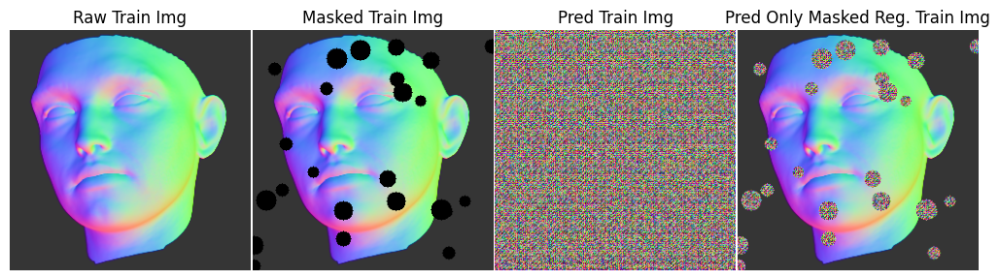

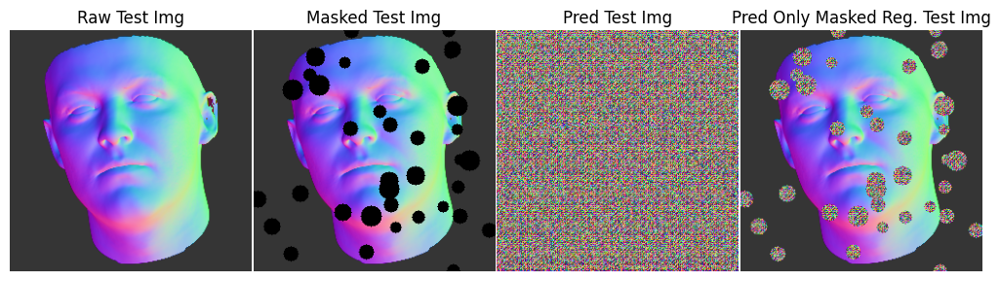

In [25]:
generator_plot_images(generator, 'Train', train_dataset, num = 1)
generator_plot_images(generator, 'Test', test_dataset, num = 1)

In [26]:
print("Generator Loss: ", generator_loss(fake_decision, raw_images_examples,pred_images_examples))
print("Generator SSIM: ", generator_ssim(raw_images_examples,pred_images_examples))
print("Generator PSNR: ", generator_psnr(raw_images_examples,pred_images_examples))

Generator Loss:  tf.Tensor(1023.73083, shape=(), dtype=float32)
Generator SSIM:  tf.Tensor(0.010170404, shape=(), dtype=float32)
Generator PSNR:  tf.Tensor(10.79119, shape=(), dtype=float32)


# Training Code Set

### Define Generator and Discriminator training steps for a batch

In [27]:
@tf.function
def train_generator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as gen_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=True)
        train_fake_output = discriminator(train_generated_images, training=False)
        gen_loss = generator_loss(train_fake_output, train_raw_images, train_generated_images)
        gen_ssim = generator_ssim(train_raw_images, train_generated_images)
        gen_psnr = generator_psnr(train_raw_images, train_generated_images)
        
    gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    # generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))
    
    return gradients, gen_loss, gen_ssim, gen_psnr

In [28]:
@tf.function
def train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as disc_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=False)
        train_real_output = discriminator(train_raw_images, training=True)
        train_fake_output = discriminator(train_generated_images, training=True)
        
        disc_loss = discriminator_loss(train_real_output, train_fake_output)
        disc_acc = discirminator_acc(train_real_output, train_fake_output)

    gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    # discriminator_optimizer.apply_gradients(zip(gradients, discriminator.trainable_variables))
    
    return gradients, disc_loss, disc_acc

### Define a function to train a list of batches

In [29]:
def train_batches(batches_list):
    gen_loss_total = 0
    gen_ssim_total = 0
    gen_psnr_total = 0
    disc_loss_total = 0
    disc_acc_total = 0

    # cumulative gradient
    accumulated_gen_gradients = [tf.zeros_like(var) for var in generator.trainable_variables]
    accumulated_disc_gradients = [tf.zeros_like(var) for var in discriminator.trainable_variables]
    
    for batch in batches_list:
        train_raw_images = batch
        train_mask_channels = mask_irregular(train_raw_images.shape[0], train_raw_images.shape[1], train_raw_images.shape[2])
        train_masked_images = masked_imgs(train_raw_images, train_mask_channels)
        
        gen_gradients, gen_loss, gen_ssim, gen_psnr = train_generator_step(train_raw_images, train_mask_channels, train_masked_images)
        disc_gradients, disc_loss, disc_acc = train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images)

        # cumulative gradient
        for i in range(len(accumulated_gen_gradients)):
            accumulated_gen_gradients[i] += gen_gradients[i]
        for i in range(len(accumulated_disc_gradients)):
            accumulated_disc_gradients[i] += disc_gradients[i]
        
        gen_loss_total += gen_loss.numpy()
        gen_ssim_total += gen_ssim.numpy()
        gen_psnr_total += gen_psnr.numpy()
        disc_loss_total += disc_loss.numpy()
        disc_acc_total += disc_acc.numpy()

    # Applying cumulative gradients
    generator_optimizer.apply_gradients(zip(accumulated_gen_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(accumulated_disc_gradients, discriminator.trainable_variables))
    
    num_batches = len(batches_list)
    return (gen_loss_total / num_batches, gen_ssim_total / num_batches, gen_psnr_total / num_batches,
            disc_loss_total / num_batches, disc_acc_total / num_batches)

### Evaluate the function for the dataset

In [30]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_loss(fake_output, raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

### Processing batch data

In [31]:
def process_batches(dataset, batches_list_num):
    train_dataset_batches_list = []
    epoch_metrics = {
        "train_gen_loss": [], "train_gen_ssim": [], "train_gen_psnr": [], 
        "train_disc_loss": [], "train_disc_acc": []
    }

    for i, images_batch in enumerate(dataset):
        train_dataset_batches_list.append(images_batch)
        if (i + 1) % batches_list_num == 0:
            batch_metrics = train_batches(train_dataset_batches_list)
            train_dataset_batches_list = []
            for key, value in zip(epoch_metrics.keys(), batch_metrics):
                    epoch_metrics[key].append(value)

    # Check for unprocessed batch
    if train_dataset_batches_list:
        batch_metrics = train_batches(train_dataset_batches_list)
        train_dataset_batches_list = []
        for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    return epoch_metrics

### Record training information to CSV file

In [32]:
def record_training_info(log_file, current_epoch, metrics_lists, elapsed_time):
    with open(log_file, "a", newline='') as file:
        writer = csv.writer(file)
        if os.stat(log_file).st_size == 0:
            writer.writerow(["Epoch"] + list(metrics_lists.keys()) + ["Elapsed Time (Seconds)"])

        writer.writerow([current_epoch] + [sum(metrics) / len(metrics) for metrics in metrics_lists.values()] + [elapsed_time])

### Print training information

In [33]:
def print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time, checkpoint_message):
    print(f"Epoch {current_epoch}/{total_epochs}  "
          f"Train[G_Loss:{metrics_lists['train_gen_loss'][-1]:.5f} SSIM:{metrics_lists['train_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['train_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['train_disc_loss'][-1]:.5f} {metrics_lists['train_disc_acc'][-1] * 100:.3f}%]  "
          f"Test[G_Loss:{metrics_lists['test_gen_loss'][-1]:.5f} SSIM:{metrics_lists['test_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['test_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['test_disc_loss'][-1]:.5f} {metrics_lists['test_disc_acc'][-1] * 100:.3f}%] "
          f"- {elapsed_time:.0f}s  {checkpoint_message}")

### Charting metrics

In [34]:
def plot_metrics(metrics_lists):
    start_epoch = 1
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_ssim'], 
                     'Generator Loss and SSIM', 'SSIM', start=start_epoch)
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_psnr'], 
                     'Generator Loss and PSNR', 'PSNR', start=start_epoch)
    plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
                     metrics_lists['test_disc_loss'], metrics_lists['test_disc_acc'], 
                     'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

In [35]:
def load_metrics_from_csv(log_file):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                for key in metrics_lists.keys():
                    metrics_lists[key].append(float(row[key]))

    return metrics_lists

### Save checkpoints

In [36]:
checkpoint_dir = './training_checkpoints'
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)

### Restore the latest saved checkpoint (if exist)

In [37]:
checkpoint.restore(checkpoint_manager.latest_checkpoint)

### Restoring Training Logs from Previous Sessions

In [38]:
def display_saved_images(epoch, image_path='./saved_images'):
    train_image_path = os.path.join(image_path, f'Train_epoch_{epoch}.png')
    test_image_path = os.path.join(image_path, f'Test_epoch_{epoch}.png')

    if os.path.exists(train_image_path):
        train_image = mpimg.imread(train_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(train_image)
        plt.axis('off')
        plt.show()

    if os.path.exists(test_image_path):
        test_image = mpimg.imread(test_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(test_image)
        plt.axis('off')
        plt.show()

In [39]:
def load_metrics_until_epoch(log_file, epoch):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                if int(row['Epoch']) <= epoch:
                    for key in metrics_lists.keys():
                        metrics_lists[key].append(float(row[key]))

    return metrics_lists

In [40]:
def read_last_epoch(log_file, total_epochs, epoch_break):
    last_valid_epoch = 0
    cleaned_data = []

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            rows = list(csv.reader(file))
            header = rows[0]
            data_rows = rows[1:]

            # Find a multiple of the last epoch_break
            for row in reversed(data_rows):
                epoch = int(row[0])
                if epoch % epoch_break == 0:
                    last_valid_epoch = epoch
                    cleaned_data = data_rows[:data_rows.index(row) + 1]
                    break

            #  If a matching epoch is found, rewrite the file
            if cleaned_data:
                with open(log_file, "w", newline='') as file:
                    writer = csv.writer(file)
                    writer.writerow(header)
                    writer.writerows(cleaned_data)

            # Reprint previous training information
            for data in cleaned_data:
                current_epoch = int(data[0])
                elapsed_time = float(data[-1])
                metrics_lists = {
                    'train_gen_loss': [float(data[1])],
                    'train_gen_ssim': [float(data[2])],
                    'train_gen_psnr': [float(data[3])],
                    'train_disc_loss': [float(data[4])],
                    'train_disc_acc': [float(data[5])],
                    'test_gen_loss': [float(data[6])],
                    'test_gen_ssim': [float(data[7])],
                    'test_gen_psnr': [float(data[8])],
                    'test_disc_loss': [float(data[9])],
                    'test_disc_acc': [float(data[10])]
                }
                print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time)

                if current_epoch % epoch_break == 0:
                    display_saved_images(current_epoch)
                    plot_metrics(load_metrics_until_epoch(log_file, current_epoch))

    return last_valid_epoch

### Training

In [41]:
class EarlyStopping:
    def __init__(self, monitor='val_loss', patience=10, verbose=False, epoch_break=25):
        self.monitor = monitor
        self.patience = patience
        self.verbose = verbose
        self.epoch_break = epoch_break
        self.best_val = float('inf')
        self.wait = 0
        self.stopped_epoch = 0
        self.should_stop = False  # Whether stopping conditions are met
        self.stop_training = False  # Practical stop training

    def on_epoch_end(self, epoch, current_val):
        if current_val < self.best_val:
            self.best_val = current_val
            self.wait = 0
        else:
            self.wait += 1
            if self.wait >= self.patience:
                self.stopped_epoch = epoch
                self.should_stop = True
                if self.verbose:
                    print(f"EarlyStopping: Condition met to stop training at epoch {epoch + 1}")

    def check_stop_training(self, epoch):
        # Check if training stops at multiples of epoch_break
        if self.should_stop and (epoch + 1) % self.epoch_break == 0:
            self.stop_training = True
            if self.verbose:
                print(f"EarlyStopping: Stopping training at epoch {epoch + 1}")

In [42]:
class ModelCheckpoint:
    def __init__(self, checkpoint_manager, gen_filepath, disc_filepath, monitor='val_loss', verbose=False):
        self.checkpoint_manager = checkpoint_manager
        self.gen_filepath = gen_filepath
        self.disc_filepath = disc_filepath
        self.monitor = monitor
        self.verbose = verbose
        self.best_val = float('inf')

    def on_epoch_end(self, epoch, current_val, generator, discriminator):
        message = ""
        if current_val < self.best_val:
            self.best_val = current_val
            generator.save(self.gen_filepath)
            discriminator.save(self.disc_filepath)
            self.checkpoint_manager.save()
            if self.verbose:
                message = f"Checkpoint&Models saved (epoch {epoch + 1})"
        return message

In [43]:
def train(train_dataset, test_dataset, max_epochs, epoch_break, batches_list_num, generator, discriminator):
    
    log_dir = './saved_logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, "GAN_training_results.csv")
    
    # Read the last completed epoch
    start_epoch = read_last_epoch(log_file, max_epochs, epoch_break)
    
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }
    

    model_checkpoint = ModelCheckpoint(
        checkpoint_manager=checkpoint_manager,
        gen_filepath='./saved_model/generator_best.h5',
        disc_filepath='./saved_model/discriminator_best.h5',
        monitor='test_gen_loss', verbose=True
    )

    early_stopper = EarlyStopping(monitor='test_gen_loss', patience=25, verbose=True, epoch_break=epoch_break) # Early Stopping
        
    for epoch in range(start_epoch, max_epochs):
        start_time = time.time()

        # # For Train
        epoch_metrics = process_batches(train_dataset, batches_list_num)
        for key in epoch_metrics.keys():
            metrics_lists[key].append(sum(epoch_metrics[key]) / len(epoch_metrics[key]))
                    
        # For Test
        test_metrics = assessment(test_dataset)
        for key, value in test_metrics.items():
            metrics_lists['test_' + key].append(value)
        
        # Save Training Information
        current_epoch = epoch + 1
        elapsed_time = time.time() - start_time
        record_training_info(log_file, current_epoch, metrics_lists, elapsed_time)
        
        # Check and save best model
        current_val = metrics_lists['test_gen_loss'][-1]
        checkpoint_message = model_checkpoint.on_epoch_end(epoch, current_val, generator, discriminator)

        # Print Training Information
        print_training_info(current_epoch, max_epochs, metrics_lists, elapsed_time, checkpoint_message)
        
        # Checking early stop conditions
        current_val = metrics_lists['test_gen_loss'][-1]
        early_stopper.on_epoch_end(epoch, current_val)

        # Check if training stops at multiples of epoch_break
        early_stopper.check_stop_training(epoch)
        if early_stopper.stop_training:
            print(f"Early stopping triggered at epoch {epoch + 1}")
            break
        
        # Epoch output results with set intervals
        if (epoch + 1) % epoch_break == 0:
              
            generator_plot_images(generator, 'Train', train_dataset, epoch=current_epoch, save_images=True)
            generator_plot_images(generator, 'Test', test_dataset, epoch=current_epoch, save_images=True)

            plot_metrics(load_metrics_from_csv(log_file))

Epoch 1/1000  Train[G_Loss:980.85479 SSIM:0.73% PSNR:10.76 Disc:0.27984 86.852%]  Test[G_Loss:1058.85658 SSIM:-0.01% PSNR:10.66 Disc:1.03692 50.000%] - 27s  Checkpoint&Models saved (epoch 1)
Epoch 2/1000  Train[G_Loss:920.36833 SSIM:1.27% PSNR:10.81 Disc:0.00103 100.000%]  Test[G_Loss:1014.79095 SSIM:0.53% PSNR:10.71 Disc:1.20230 50.000%] - 3s  Checkpoint&Models saved (epoch 2)
Epoch 3/1000  Train[G_Loss:829.40595 SSIM:2.05% PSNR:10.89 Disc:0.03400 100.000%]  Test[G_Loss:958.54517 SSIM:1.16% PSNR:10.77 Disc:0.78723 50.000%] - 3s  Checkpoint&Models saved (epoch 3)
Epoch 4/1000  Train[G_Loss:745.21523 SSIM:2.75% PSNR:10.95 Disc:0.03846 99.852%]  Test[G_Loss:751.08199 SSIM:2.84% PSNR:10.94 Disc:0.08894 100.000%] - 3s  Checkpoint&Models saved (epoch 4)
Epoch 5/1000  Train[G_Loss:678.46394 SSIM:3.37% PSNR:11.00 Disc:0.00022 100.000%]  Test[G_Loss:642.55931 SSIM:3.61% PSNR:11.03 Disc:0.03491 100.000%] - 3s  Checkpoint&Models saved (epoch 5)
Epoch 6/1000  Train[G_Loss:618.17496 SSIM:3.98% PSN

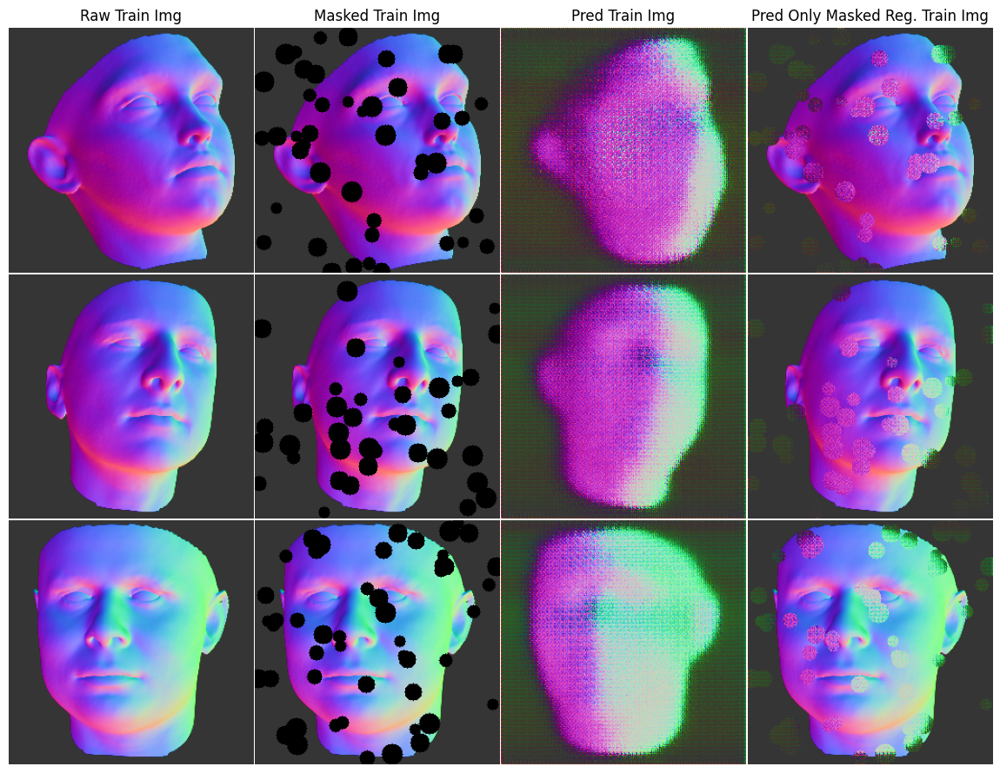

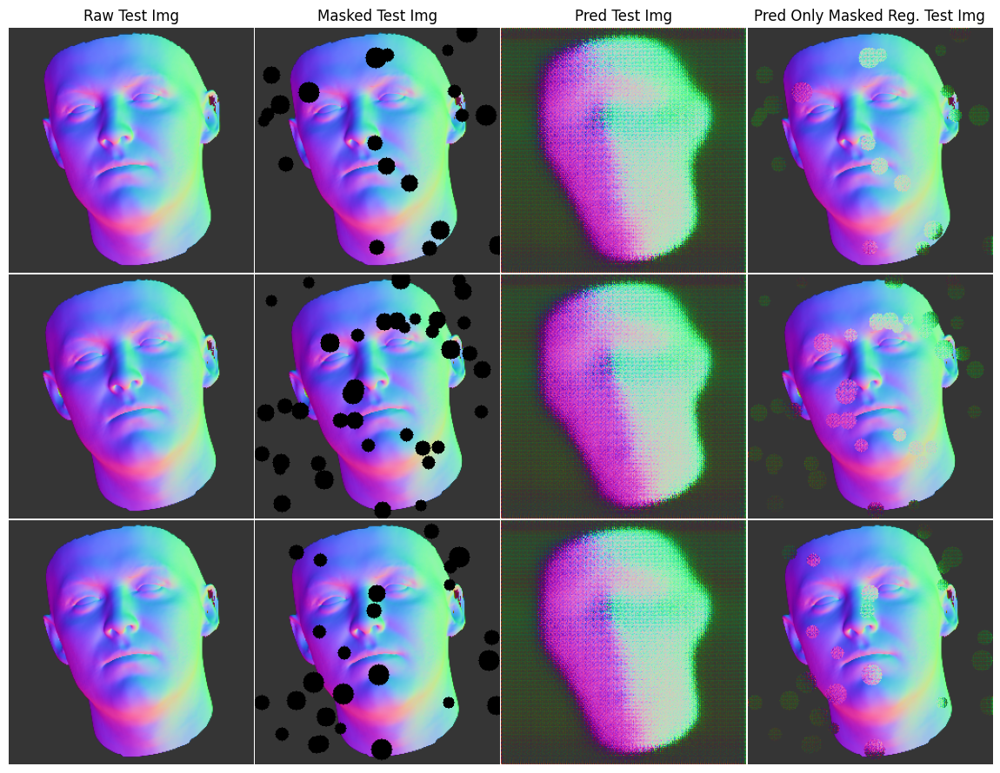

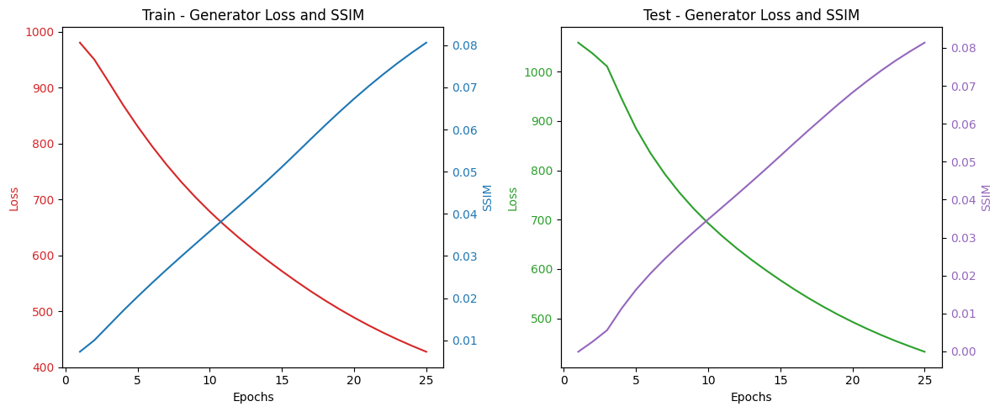

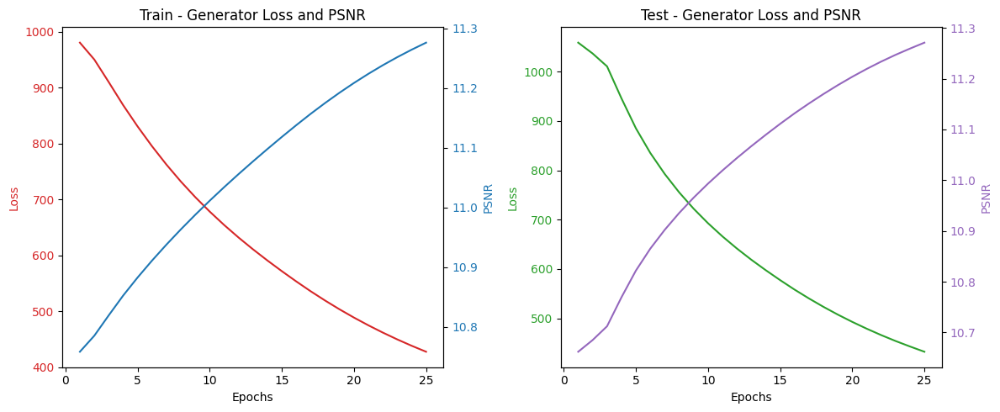

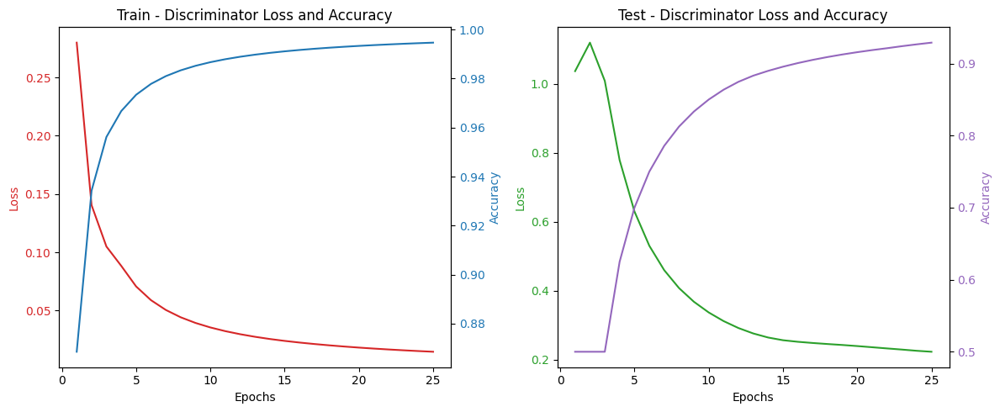

Epoch 26/1000  Train[G_Loss:165.33676 SSIM:13.88% PSNR:11.56 Disc:0.00025 100.000%]  Test[G_Loss:176.17877 SSIM:13.90% PSNR:11.55 Disc:0.16630 98.571%] - 3s  Checkpoint&Models saved (epoch 26)
Epoch 27/1000  Train[G_Loss:160.80692 SSIM:14.03% PSNR:11.57 Disc:0.00023 100.000%]  Test[G_Loss:170.11400 SSIM:13.99% PSNR:11.56 Disc:0.16992 98.571%] - 3s  Checkpoint&Models saved (epoch 27)
Epoch 28/1000  Train[G_Loss:155.03931 SSIM:14.19% PSNR:11.57 Disc:0.00024 100.000%]  Test[G_Loss:161.88106 SSIM:14.26% PSNR:11.57 Disc:0.16717 98.571%] - 3s  Checkpoint&Models saved (epoch 28)
Epoch 29/1000  Train[G_Loss:148.61233 SSIM:14.34% PSNR:11.58 Disc:0.00025 100.000%]  Test[G_Loss:158.00835 SSIM:14.35% PSNR:11.57 Disc:0.17005 98.571%] - 3s  Checkpoint&Models saved (epoch 29)
Epoch 30/1000  Train[G_Loss:143.32436 SSIM:14.46% PSNR:11.58 Disc:0.00020 100.000%]  Test[G_Loss:153.28331 SSIM:14.48% PSNR:11.57 Disc:0.17253 99.048%] - 3s  Checkpoint&Models saved (epoch 30)
Epoch 31/1000  Train[G_Loss:137.948

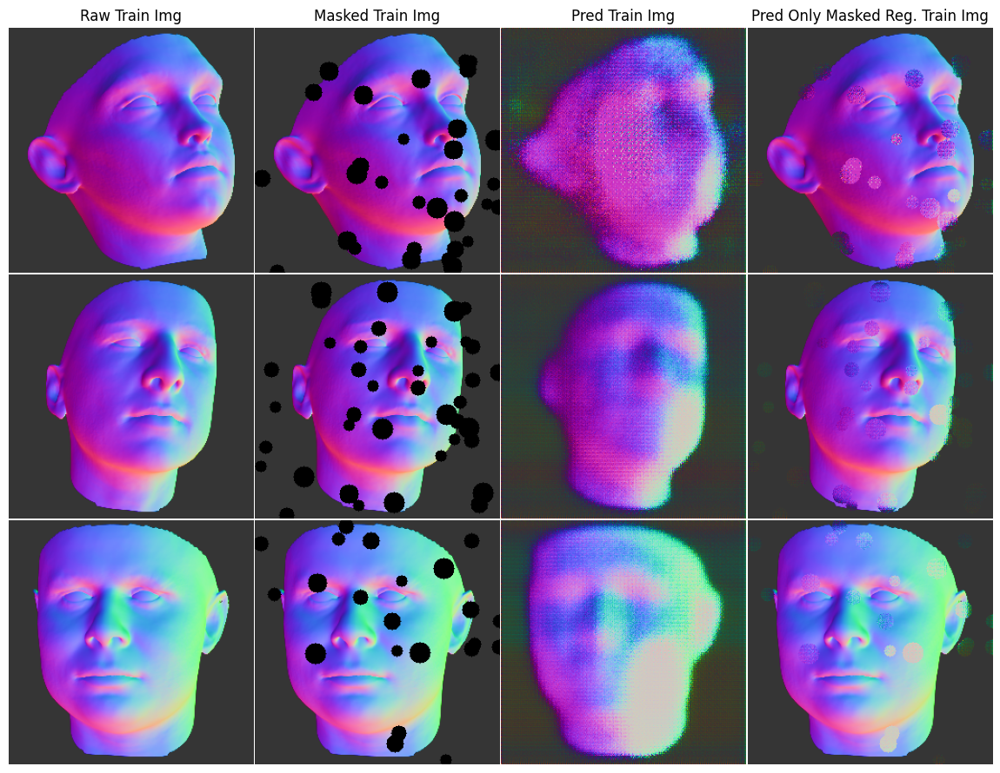

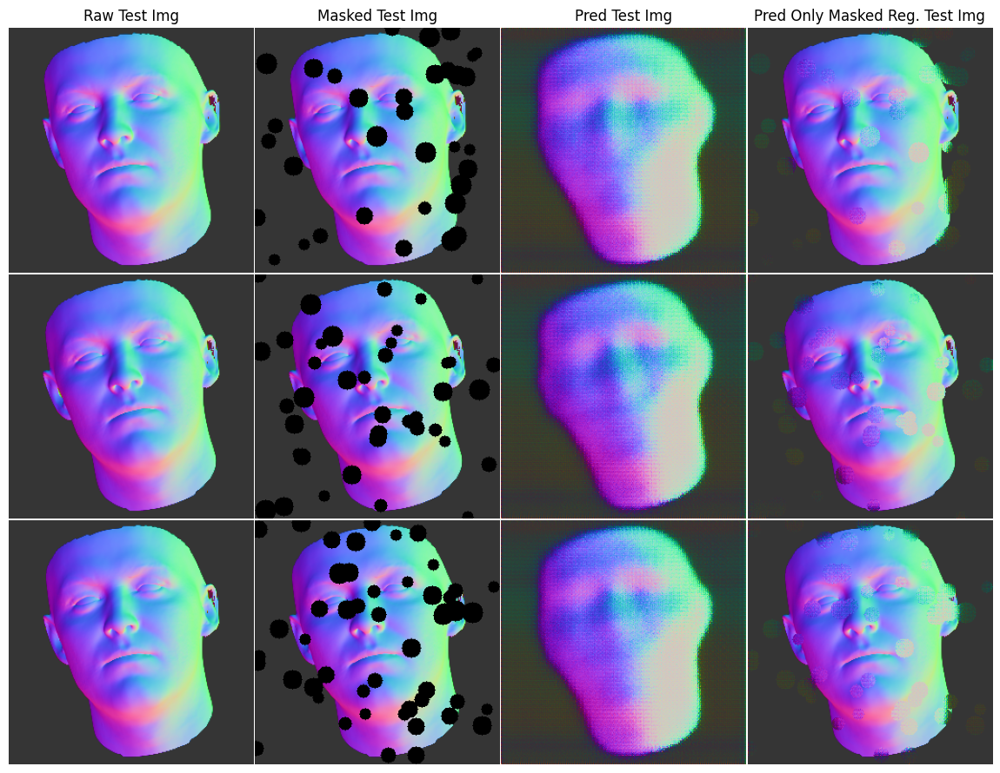

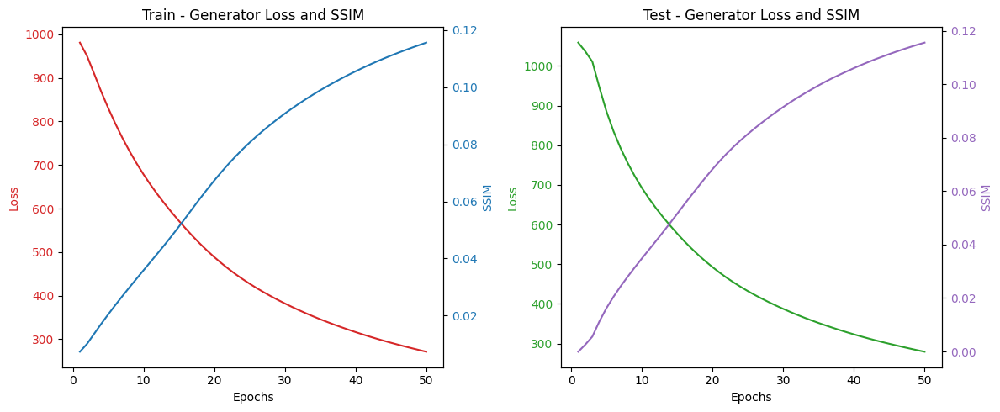

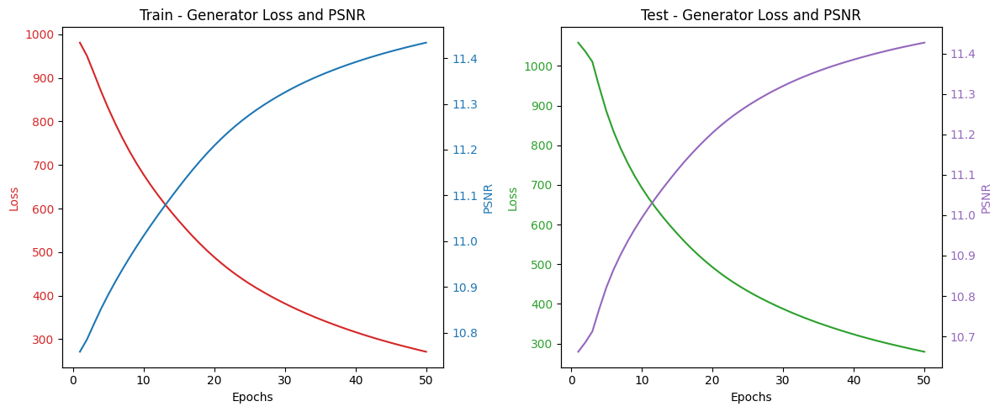

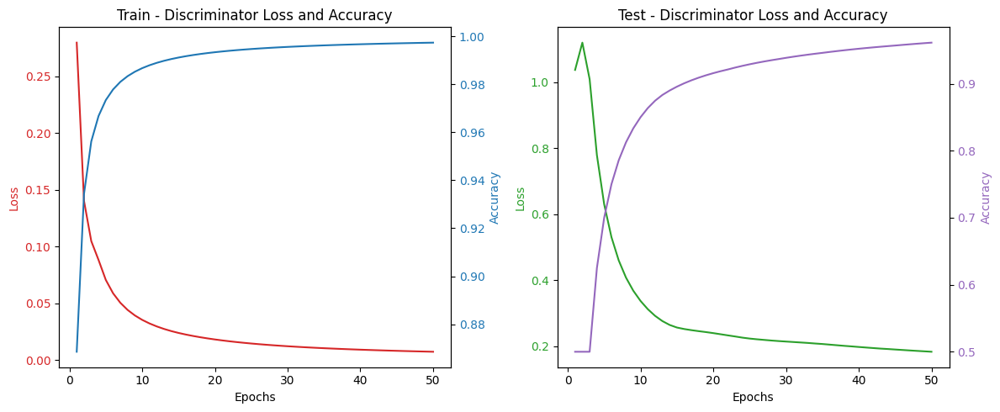

Epoch 51/1000  Train[G_Loss:79.93664 SSIM:15.71% PSNR:11.61 Disc:0.00005 100.000%]  Test[G_Loss:89.95097 SSIM:15.58% PSNR:11.60 Disc:0.11838 100.000%] - 3s  Checkpoint&Models saved (epoch 51)
Epoch 52/1000  Train[G_Loss:76.85002 SSIM:15.77% PSNR:11.61 Disc:0.00005 100.000%]  Test[G_Loss:88.50979 SSIM:15.58% PSNR:11.60 Disc:0.11651 100.000%] - 3s  Checkpoint&Models saved (epoch 52)
Epoch 53/1000  Train[G_Loss:74.60794 SSIM:15.75% PSNR:11.61 Disc:0.00005 100.000%]  Test[G_Loss:91.54150 SSIM:15.55% PSNR:11.60 Disc:0.11378 100.000%] - 3s  
Epoch 54/1000  Train[G_Loss:73.73975 SSIM:15.80% PSNR:11.61 Disc:0.00004 100.000%]  Test[G_Loss:84.88177 SSIM:15.60% PSNR:11.61 Disc:0.11772 100.000%] - 3s  Checkpoint&Models saved (epoch 54)
Epoch 55/1000  Train[G_Loss:71.37902 SSIM:15.84% PSNR:11.61 Disc:0.00004 100.000%]  Test[G_Loss:82.48019 SSIM:15.59% PSNR:11.61 Disc:0.10966 100.000%] - 3s  Checkpoint&Models saved (epoch 55)
Epoch 56/1000  Train[G_Loss:69.90562 SSIM:15.83% PSNR:11.61 Disc:0.00004 1

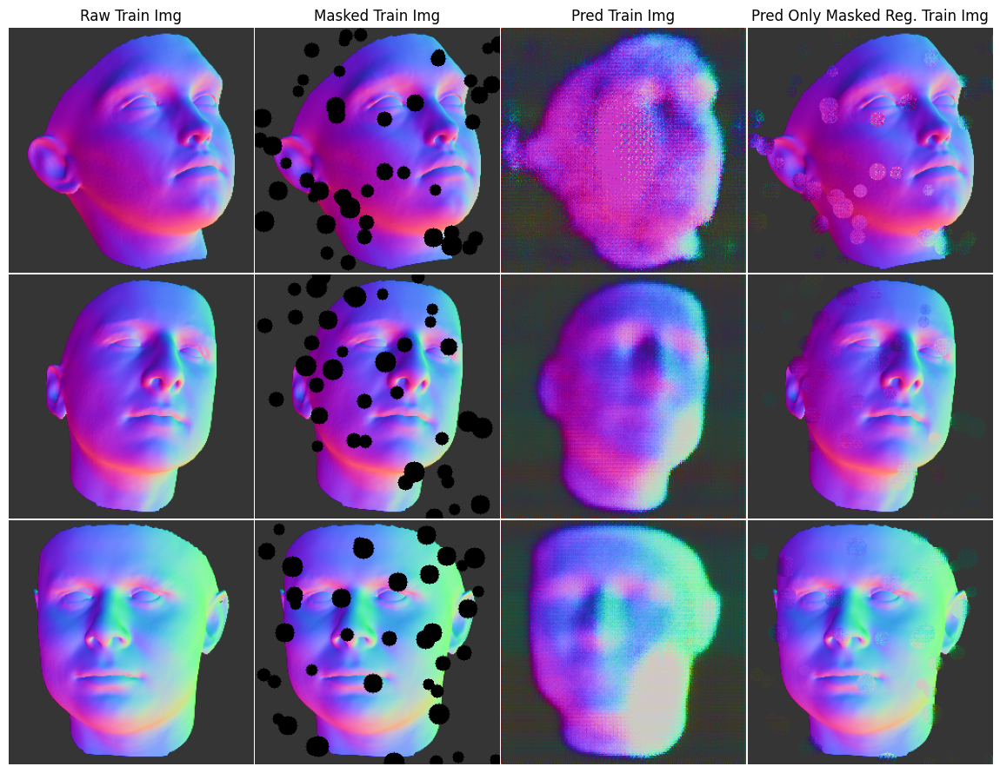

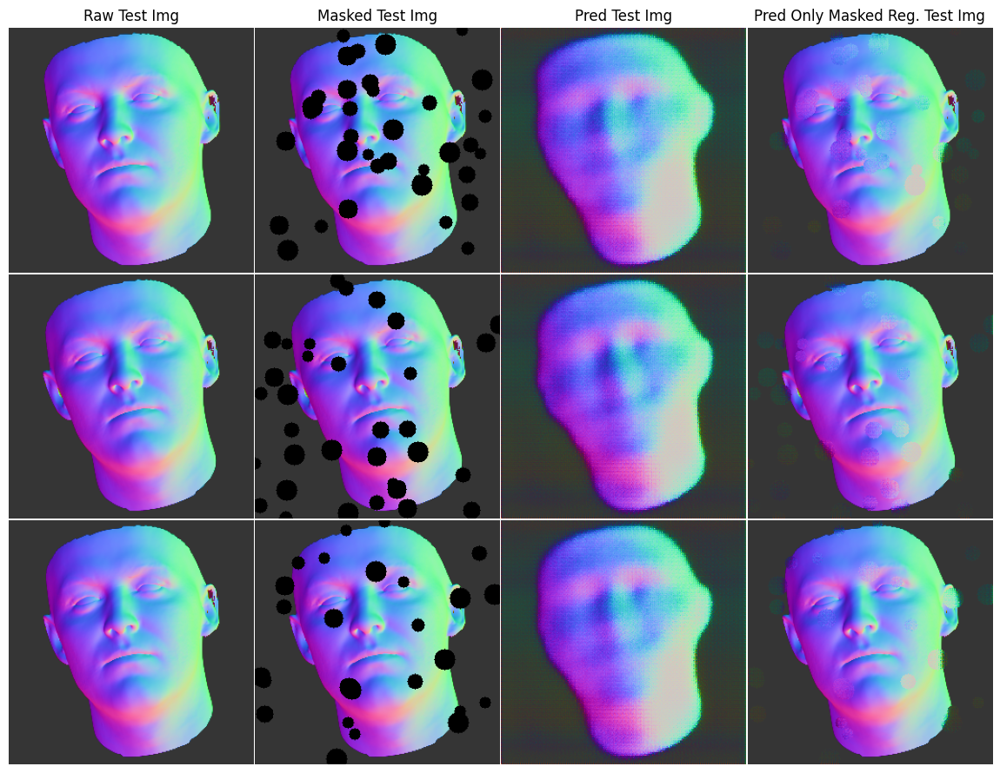

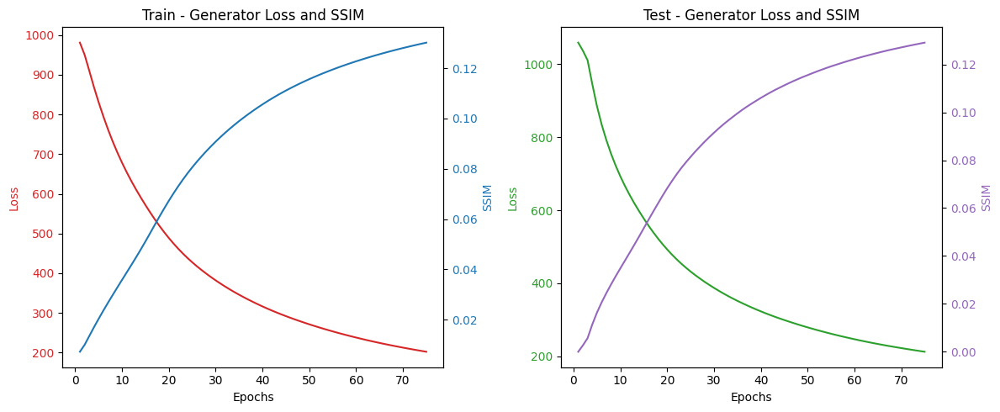

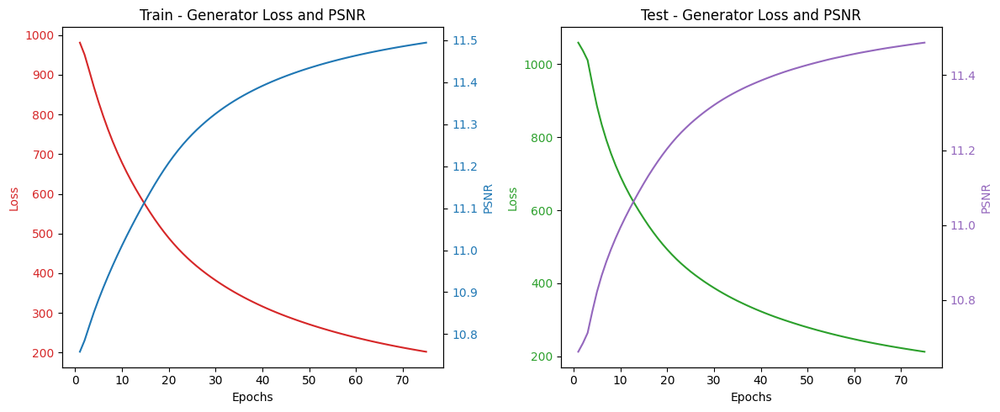

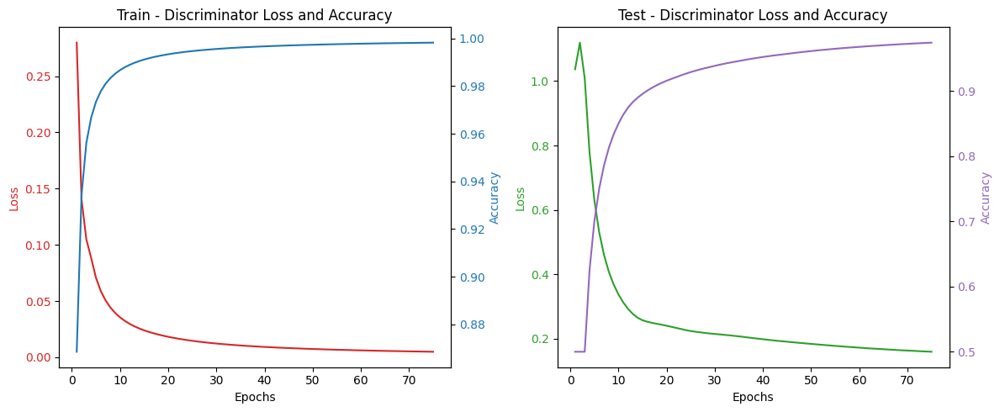

Epoch 76/1000  Train[G_Loss:52.92767 SSIM:16.07% PSNR:11.62 Disc:0.00002 100.000%]  Test[G_Loss:70.92553 SSIM:15.73% PSNR:11.61 Disc:0.11043 100.000%] - 3s  
Epoch 77/1000  Train[G_Loss:52.21060 SSIM:16.07% PSNR:11.62 Disc:0.00002 100.000%]  Test[G_Loss:69.50773 SSIM:15.71% PSNR:11.61 Disc:0.10602 100.000%] - 3s  Checkpoint&Models saved (epoch 77)
Epoch 78/1000  Train[G_Loss:51.51564 SSIM:16.08% PSNR:11.62 Disc:0.00002 100.000%]  Test[G_Loss:68.93683 SSIM:15.70% PSNR:11.61 Disc:0.11033 100.000%] - 3s  Checkpoint&Models saved (epoch 78)
Epoch 79/1000  Train[G_Loss:51.01614 SSIM:16.09% PSNR:11.62 Disc:0.00002 100.000%]  Test[G_Loss:69.38164 SSIM:15.72% PSNR:11.61 Disc:0.10618 100.000%] - 3s  
Epoch 80/1000  Train[G_Loss:51.04371 SSIM:16.08% PSNR:11.62 Disc:0.00002 100.000%]  Test[G_Loss:68.63134 SSIM:15.73% PSNR:11.61 Disc:0.10704 100.000%] - 3s  Checkpoint&Models saved (epoch 80)
Epoch 81/1000  Train[G_Loss:50.61000 SSIM:16.09% PSNR:11.62 Disc:0.00002 100.000%]  Test[G_Loss:69.25657 SSI

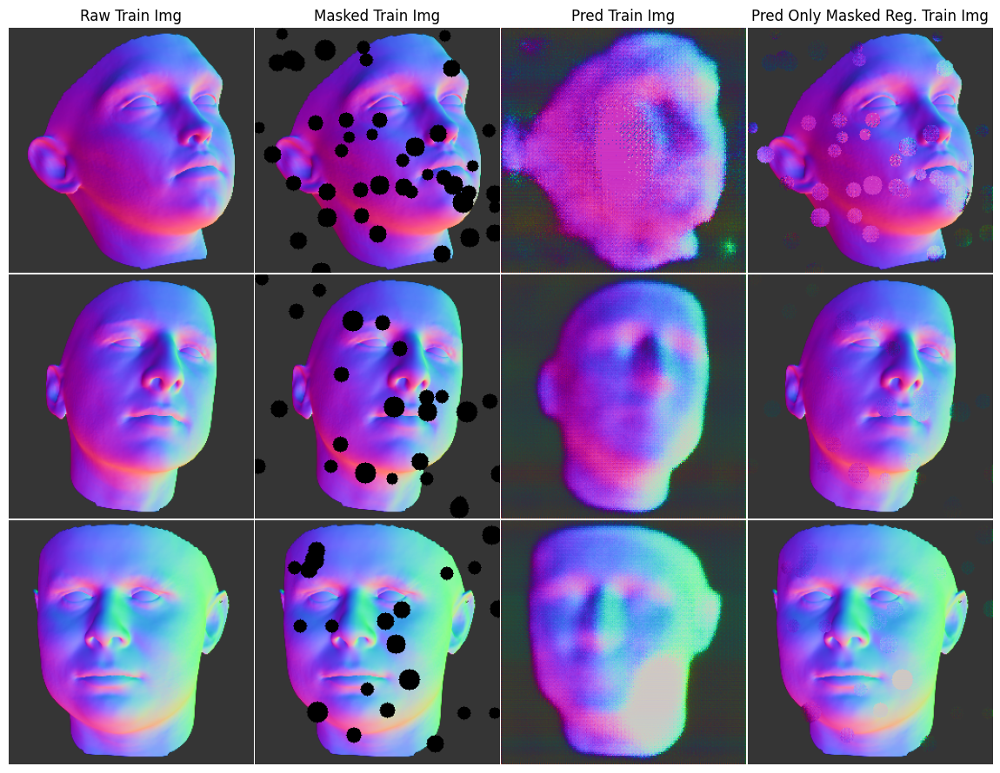

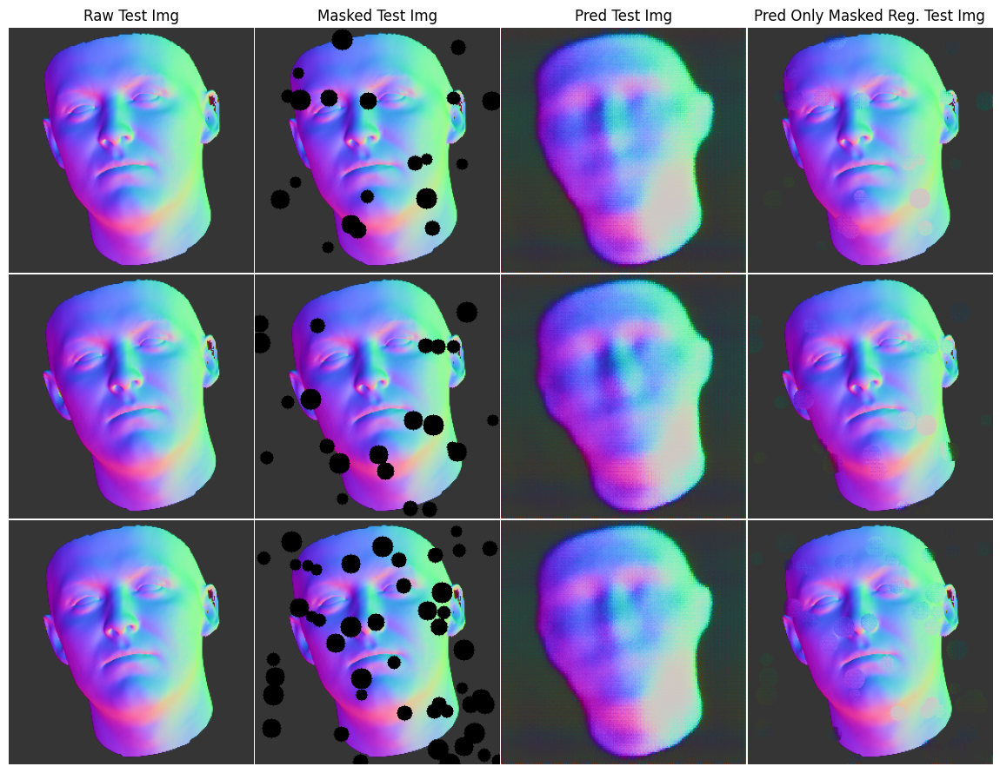

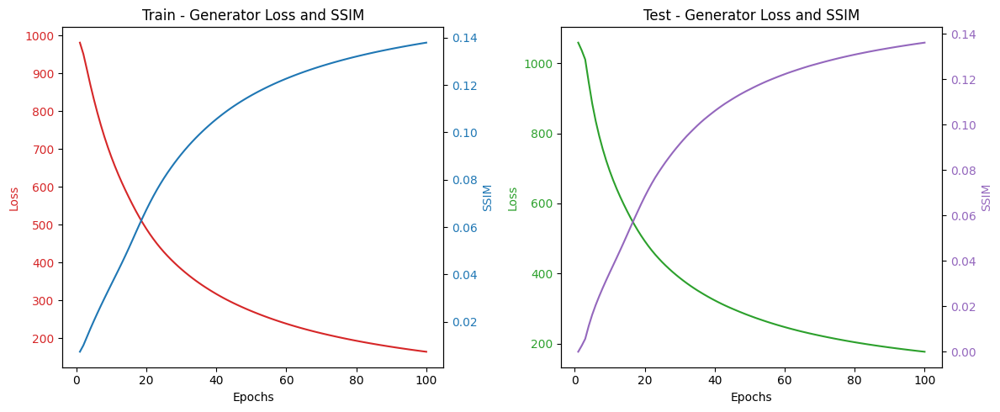

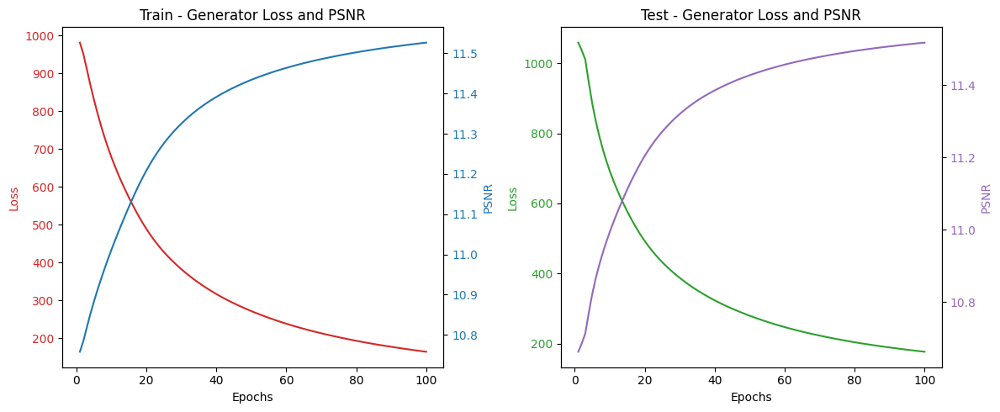

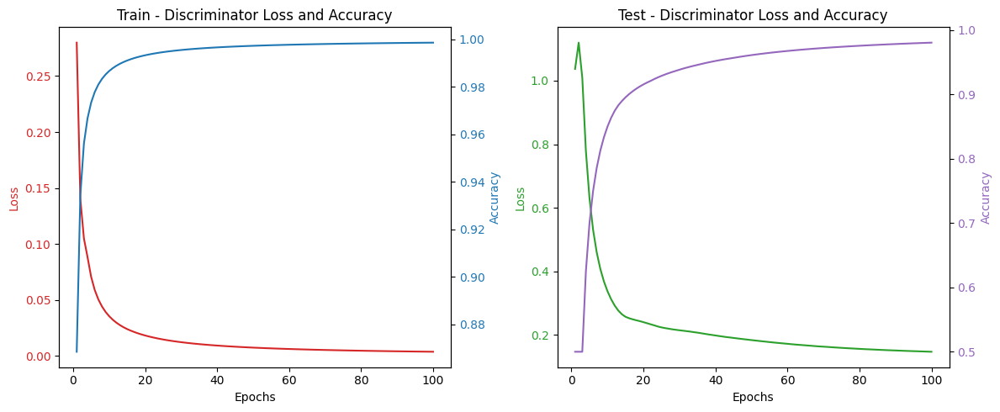

Epoch 101/1000  Train[G_Loss:43.71794 SSIM:16.18% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:67.80161 SSIM:15.73% PSNR:11.61 Disc:0.11578 100.000%] - 3s  
Epoch 102/1000  Train[G_Loss:43.78270 SSIM:16.19% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:64.83297 SSIM:15.75% PSNR:11.61 Disc:0.10929 100.000%] - 3s  
Epoch 103/1000  Train[G_Loss:43.19308 SSIM:16.20% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:62.82988 SSIM:15.80% PSNR:11.61 Disc:0.10734 100.000%] - 3s  Checkpoint&Models saved (epoch 103)
Epoch 104/1000  Train[G_Loss:42.45090 SSIM:16.22% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:65.29490 SSIM:15.73% PSNR:11.61 Disc:0.11025 100.000%] - 3s  
Epoch 105/1000  Train[G_Loss:42.43847 SSIM:16.20% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:64.08881 SSIM:15.76% PSNR:11.61 Disc:0.11518 100.000%] - 3s  
Epoch 106/1000  Train[G_Loss:41.77101 SSIM:16.21% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:64.38714 SSIM:15.79% PSNR:11.61 Disc:0.11457 100.000%] - 3s  
Epoch 107/1

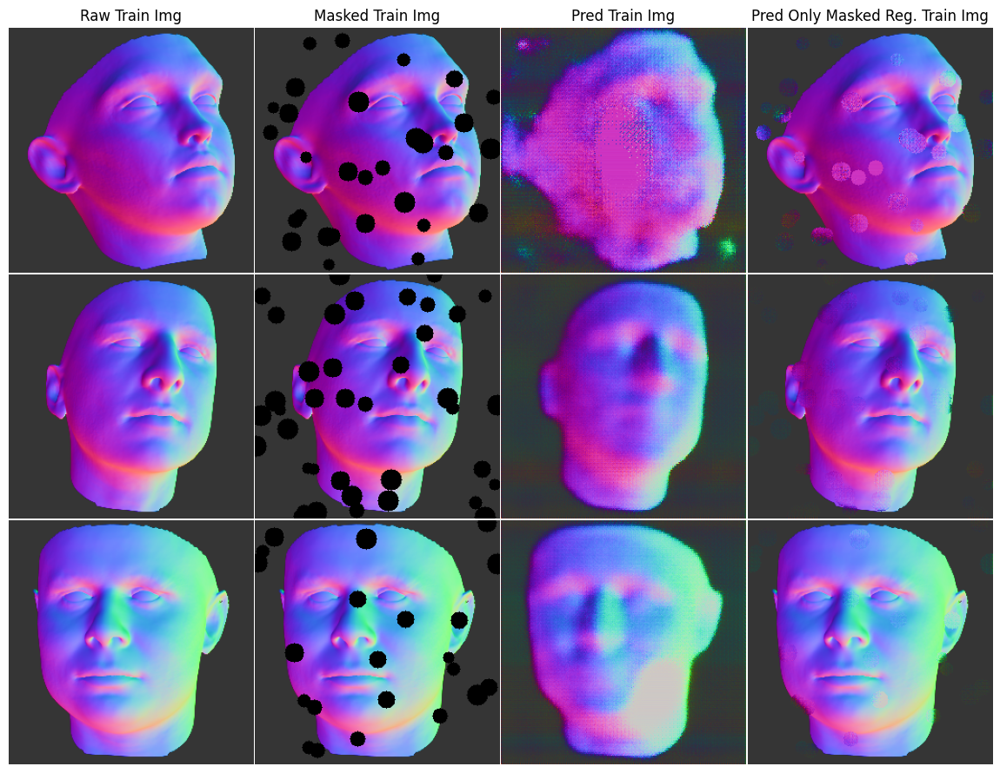

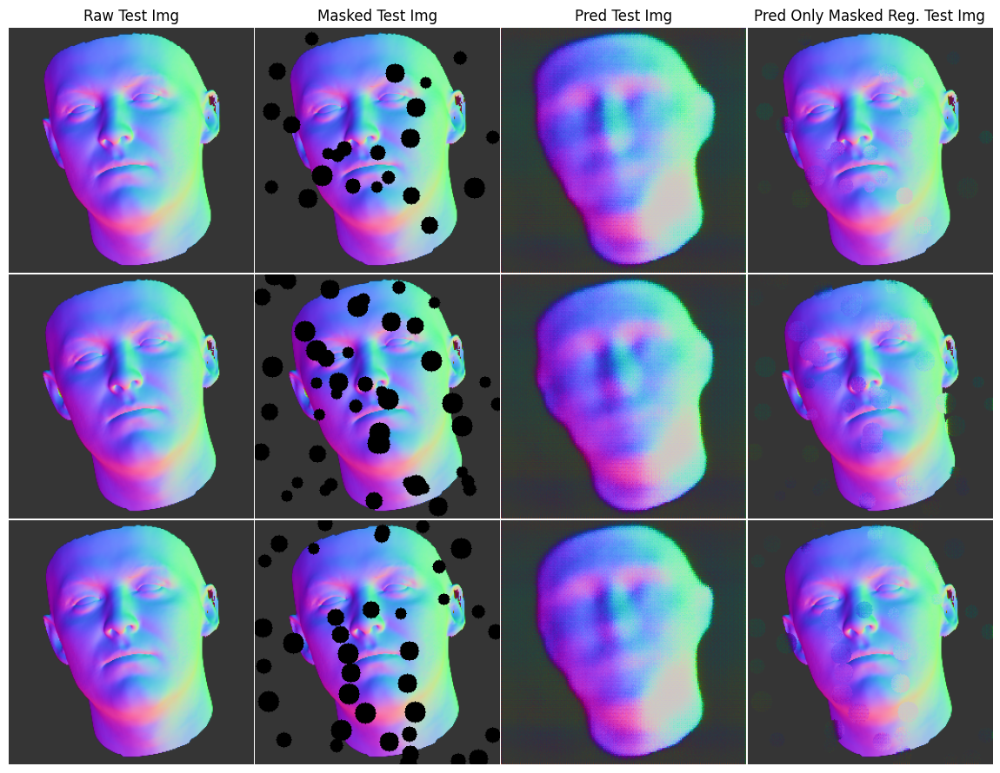

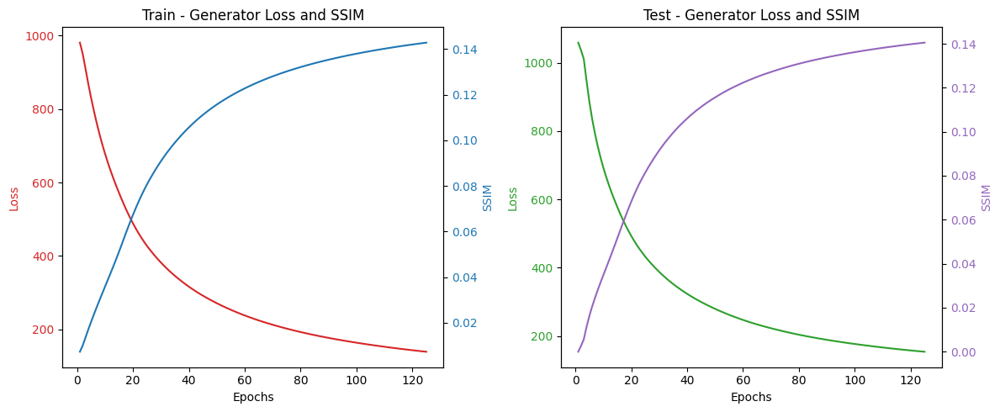

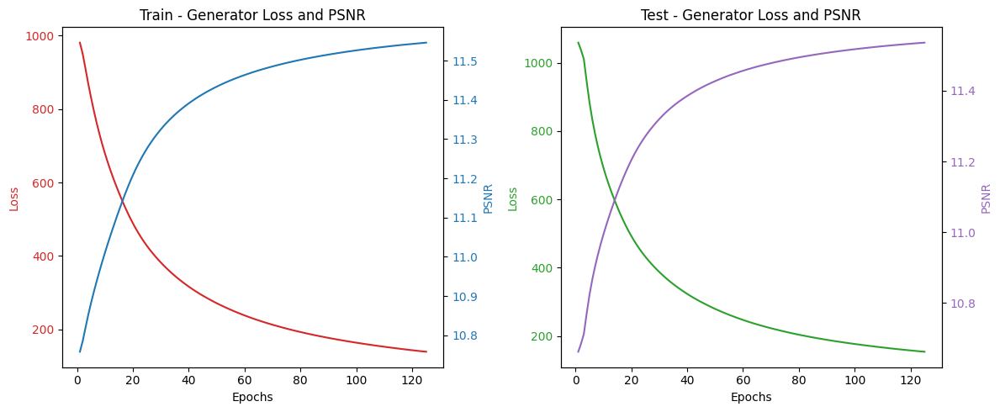

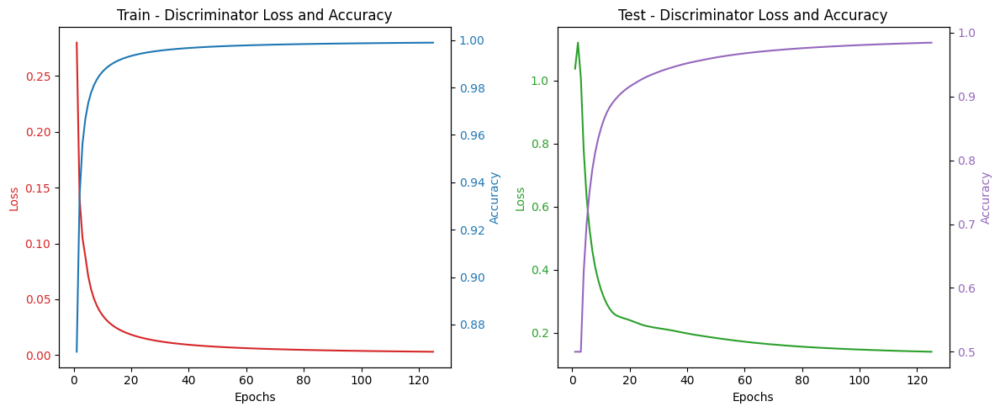

Epoch 126/1000  Train[G_Loss:38.45029 SSIM:16.26% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:60.66898 SSIM:15.82% PSNR:11.61 Disc:0.11294 100.000%] - 3s  
Epoch 127/1000  Train[G_Loss:37.44297 SSIM:16.26% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:62.16711 SSIM:15.75% PSNR:11.61 Disc:0.11670 100.000%] - 3s  
Epoch 128/1000  Train[G_Loss:37.50842 SSIM:16.27% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:60.43644 SSIM:15.83% PSNR:11.61 Disc:0.11458 100.000%] - 3s  Checkpoint&Models saved (epoch 128)
Epoch 129/1000  Train[G_Loss:36.58135 SSIM:16.28% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:60.61259 SSIM:15.80% PSNR:11.61 Disc:0.11258 100.000%] - 3s  
Epoch 130/1000  Train[G_Loss:36.50782 SSIM:16.28% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:60.17245 SSIM:15.81% PSNR:11.61 Disc:0.11165 100.000%] - 3s  Checkpoint&Models saved (epoch 130)
Epoch 131/1000  Train[G_Loss:36.08182 SSIM:16.28% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:60.70981 SSIM:15.78% PSNR:11.61 Disc:0

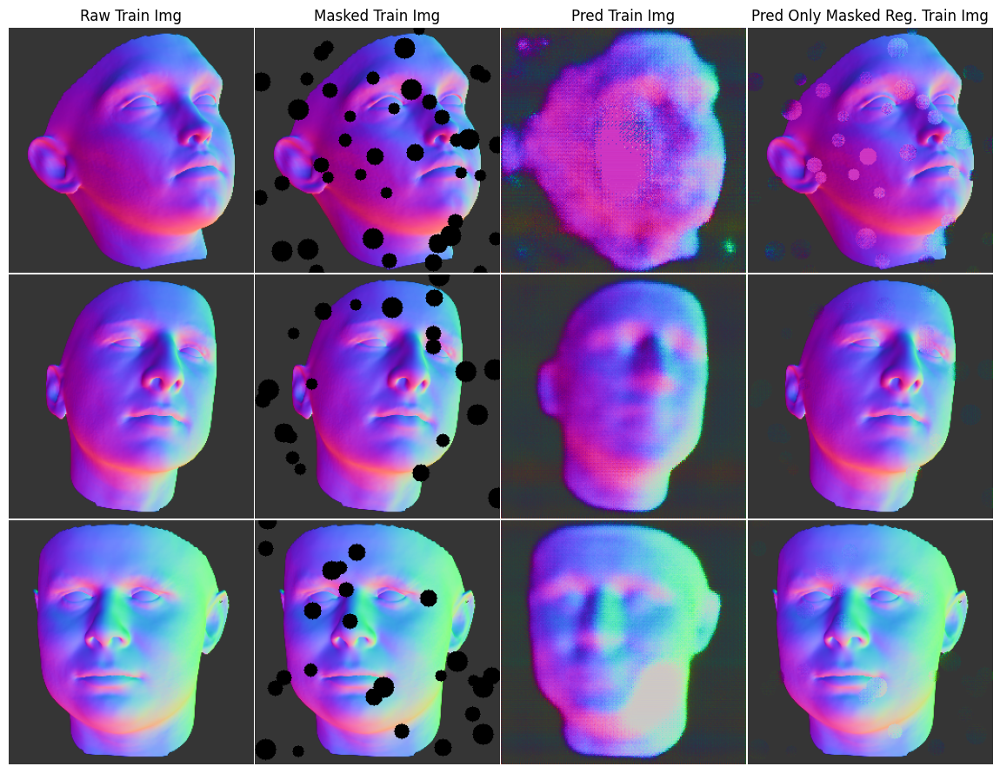

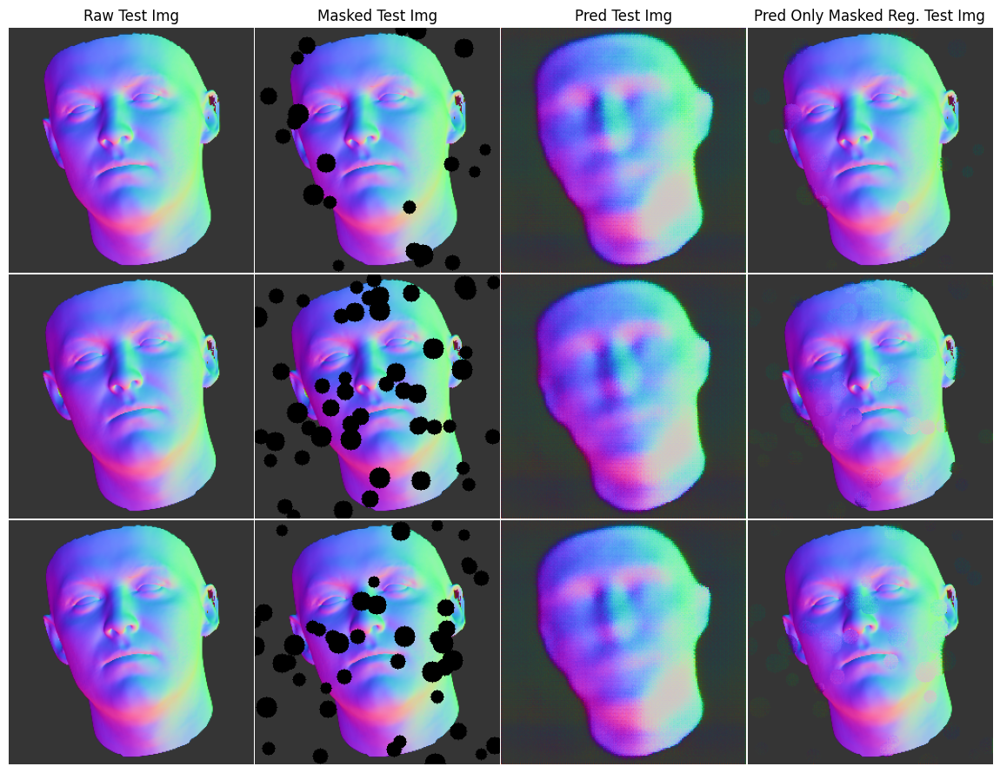

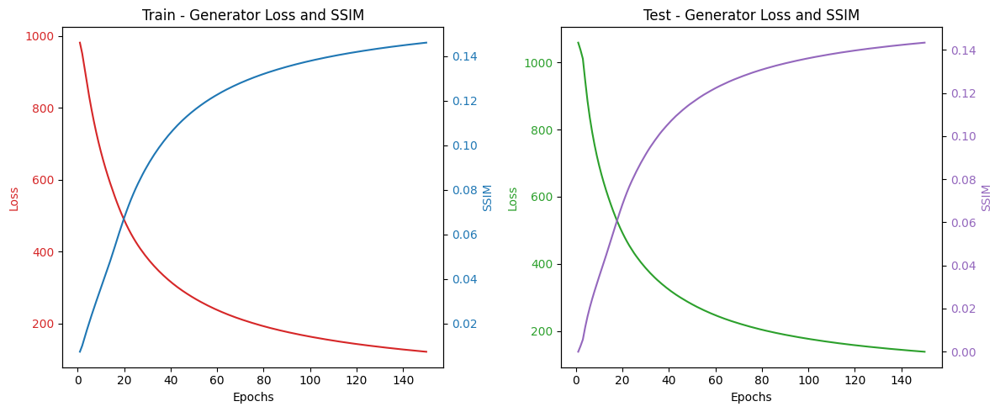

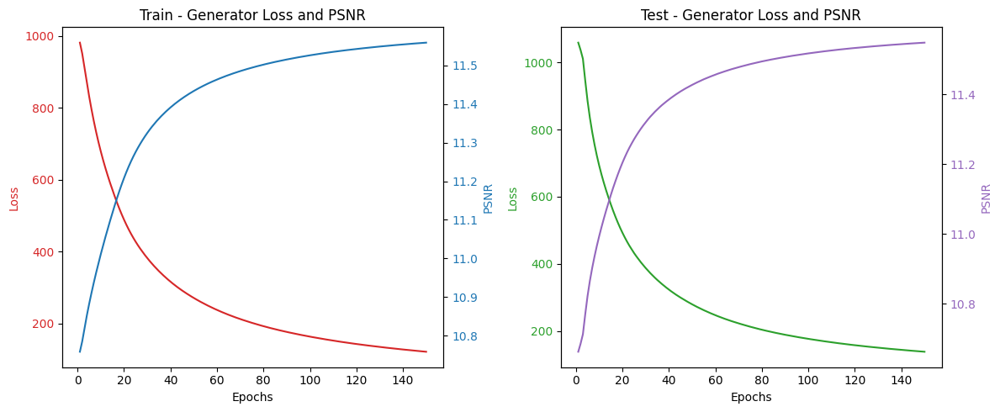

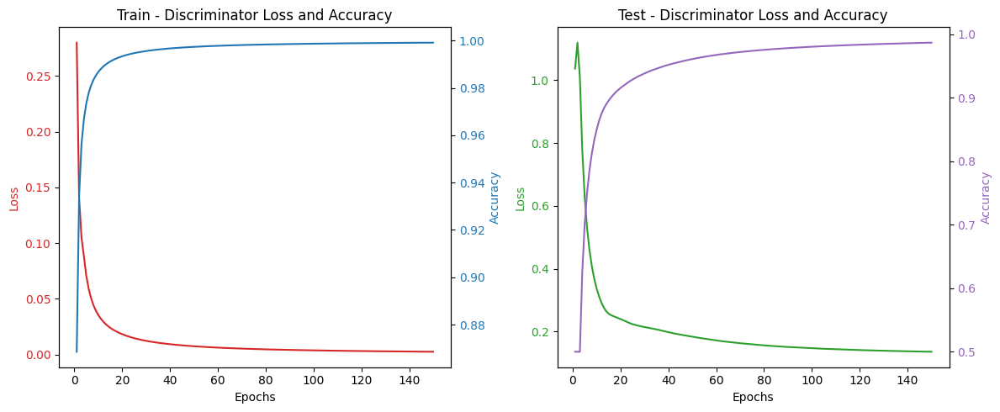

Epoch 151/1000  Train[G_Loss:32.57477 SSIM:16.29% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:58.29058 SSIM:15.80% PSNR:11.61 Disc:0.11741 100.000%] - 3s  
Epoch 152/1000  Train[G_Loss:32.53653 SSIM:16.29% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:58.02521 SSIM:15.77% PSNR:11.61 Disc:0.11214 100.000%] - 3s  
Epoch 153/1000  Train[G_Loss:32.59419 SSIM:16.29% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:58.61772 SSIM:15.78% PSNR:11.61 Disc:0.11346 100.000%] - 3s  
Epoch 154/1000  Train[G_Loss:32.54850 SSIM:16.29% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:59.20670 SSIM:15.81% PSNR:11.61 Disc:0.11829 100.000%] - 3s  
Epoch 155/1000  Train[G_Loss:32.89325 SSIM:16.29% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:58.13484 SSIM:15.81% PSNR:11.61 Disc:0.11941 100.000%] - 3s  
Epoch 156/1000  Train[G_Loss:32.39246 SSIM:16.30% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:58.37157 SSIM:15.77% PSNR:11.61 Disc:0.11343 100.000%] - 3s  
Epoch 157/1000  Train[G_Loss:32.59135 SSIM:16.

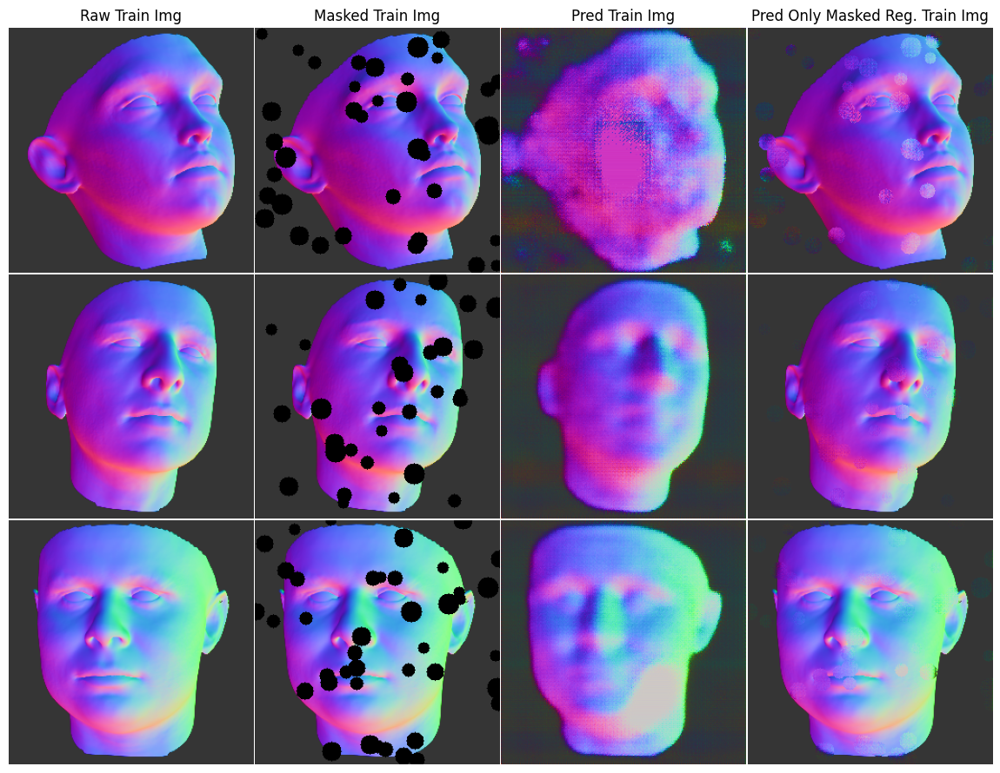

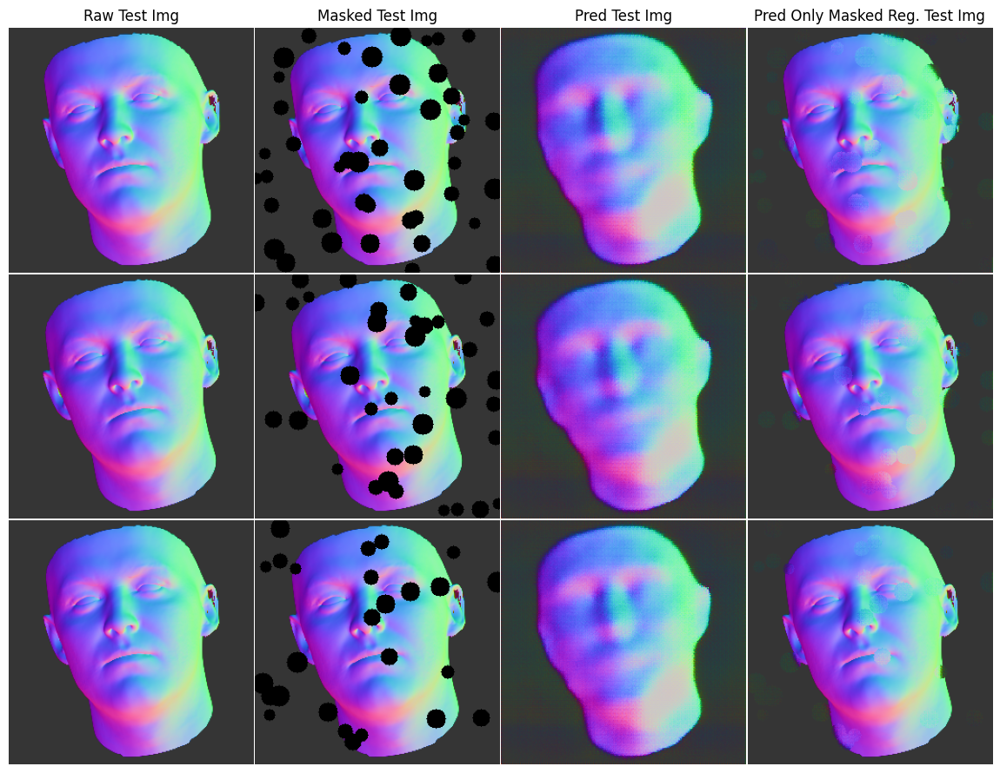

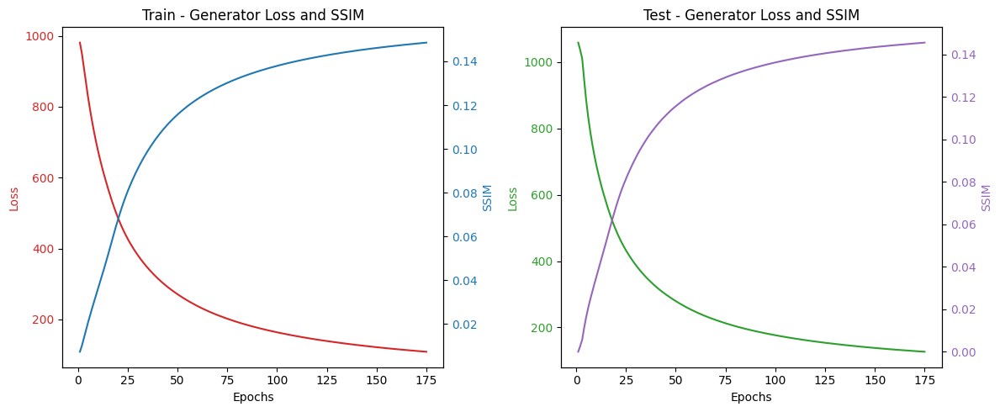

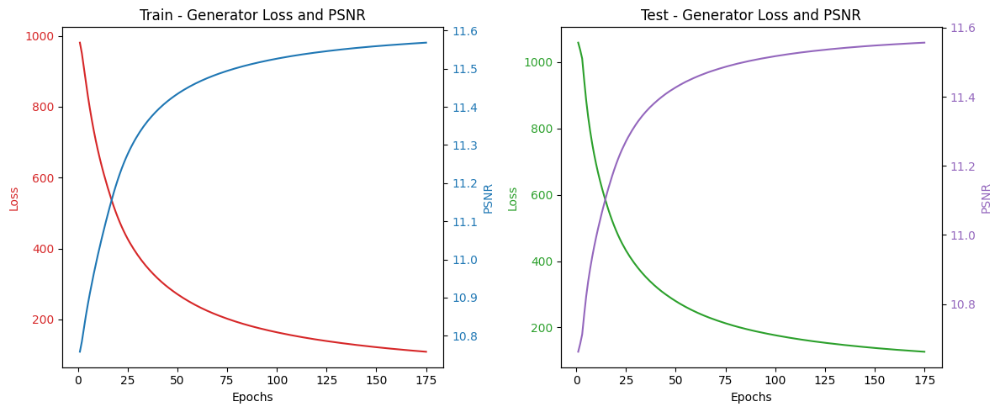

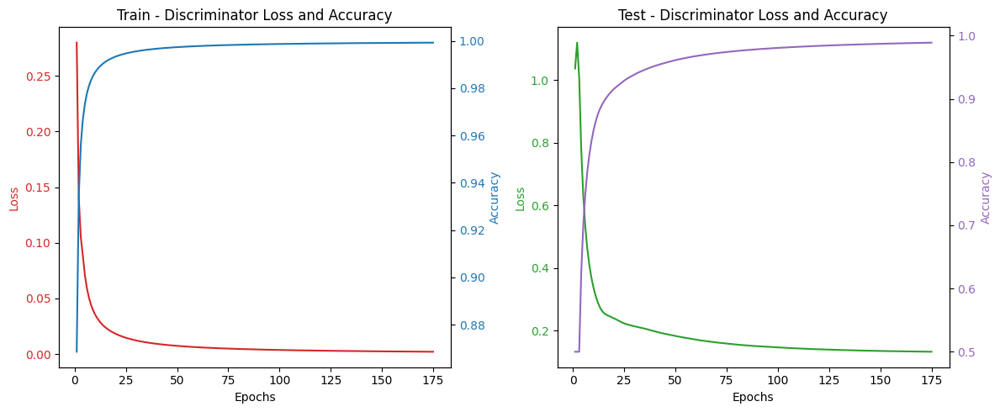

Epoch 176/1000  Train[G_Loss:29.88420 SSIM:16.32% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:56.80903 SSIM:15.80% PSNR:11.61 Disc:0.11632 100.000%] - 3s  
Epoch 177/1000  Train[G_Loss:29.85668 SSIM:16.32% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:57.84786 SSIM:15.83% PSNR:11.61 Disc:0.12406 100.000%] - 3s  
Epoch 178/1000  Train[G_Loss:29.85110 SSIM:16.32% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:57.45628 SSIM:15.85% PSNR:11.61 Disc:0.12392 100.000%] - 3s  
Epoch 179/1000  Train[G_Loss:29.62968 SSIM:16.33% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:57.79858 SSIM:15.77% PSNR:11.61 Disc:0.12234 100.000%] - 3s  
Epoch 180/1000  Train[G_Loss:29.47051 SSIM:16.32% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:56.21670 SSIM:15.81% PSNR:11.61 Disc:0.11622 100.000%] - 3s  Checkpoint&Models saved (epoch 180)
Epoch 181/1000  Train[G_Loss:29.15340 SSIM:16.33% PSNR:11.62 Disc:0.00001 100.000%]  Test[G_Loss:57.56299 SSIM:15.82% PSNR:11.61 Disc:0.12562 100.000%] - 3s  
Epoch 182/1

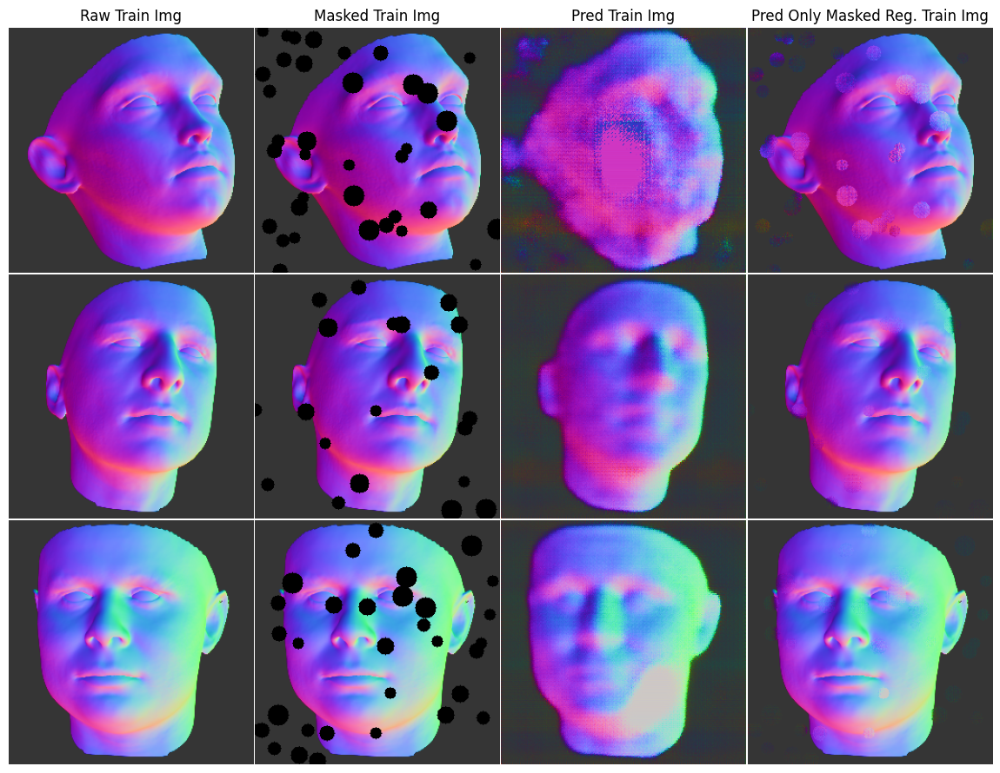

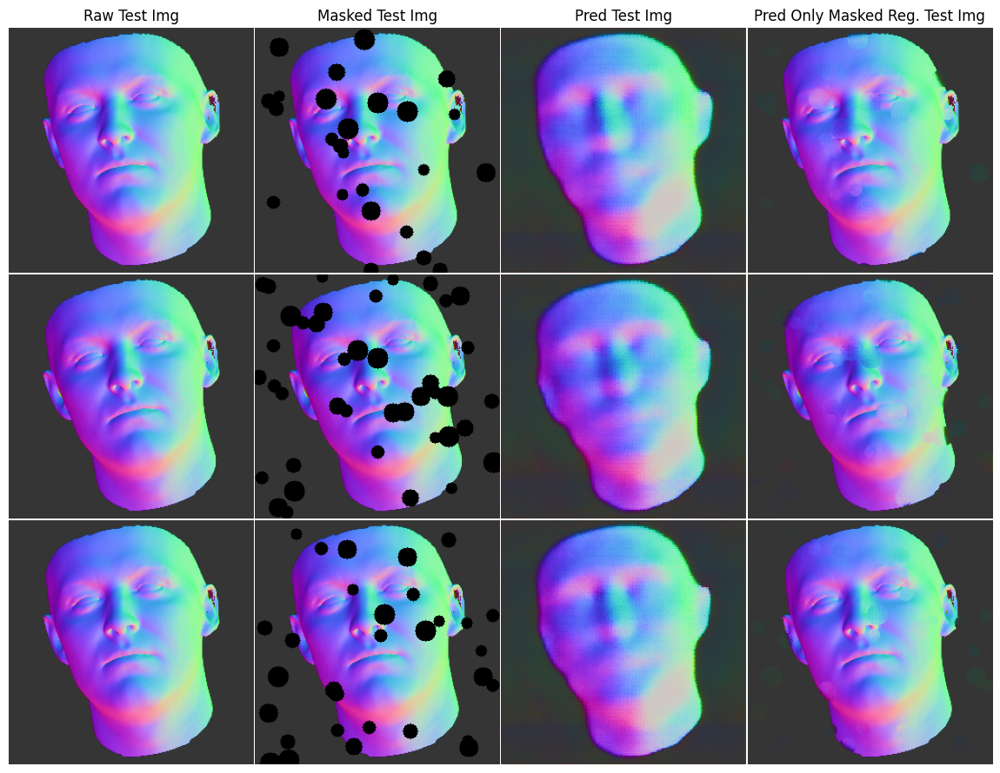

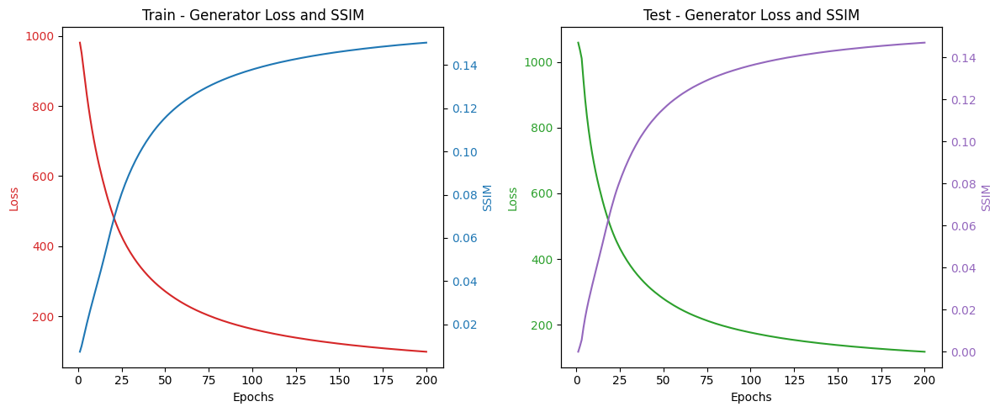

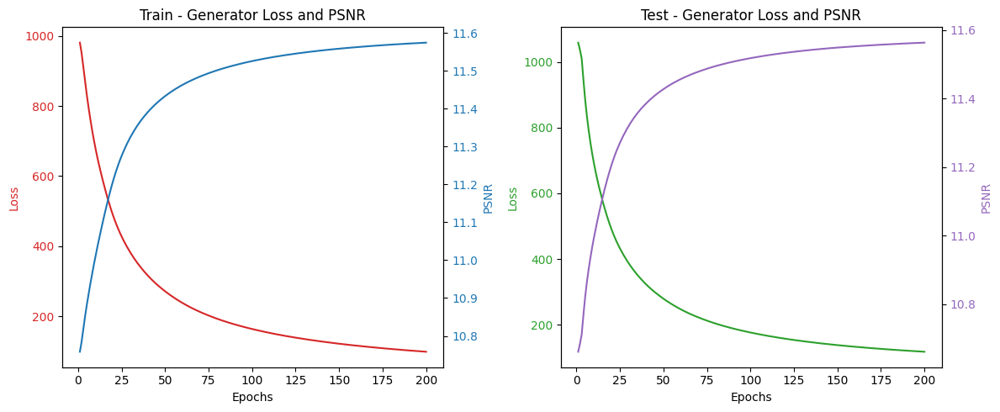

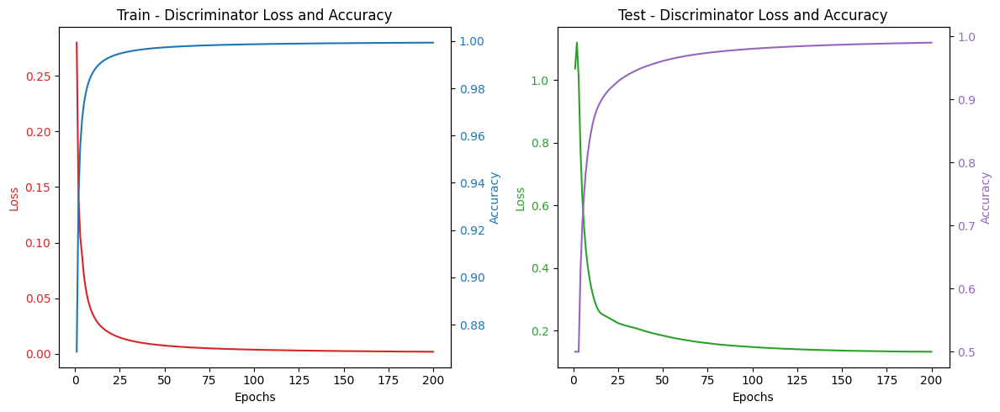

Epoch 201/1000  Train[G_Loss:26.91734 SSIM:16.30% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.52909 SSIM:15.77% PSNR:11.60 Disc:0.12378 100.000%] - 3s  Checkpoint&Models saved (epoch 201)
Epoch 202/1000  Train[G_Loss:26.75989 SSIM:16.30% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.27288 SSIM:15.75% PSNR:11.60 Disc:0.12096 100.000%] - 3s  
Epoch 203/1000  Train[G_Loss:26.91318 SSIM:16.30% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.09546 SSIM:15.81% PSNR:11.60 Disc:0.12762 100.000%] - 3s  
Epoch 204/1000  Train[G_Loss:26.79239 SSIM:16.29% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.79976 SSIM:15.78% PSNR:11.60 Disc:0.12784 100.000%] - 3s  
Epoch 205/1000  Train[G_Loss:26.68133 SSIM:16.29% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.57446 SSIM:15.73% PSNR:11.60 Disc:0.12528 100.000%] - 3s  
Epoch 206/1000  Train[G_Loss:26.99920 SSIM:16.29% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.53656 SSIM:15.77% PSNR:11.60 Disc:0.12358 100.000%] - 3s  
Epoch 207/1

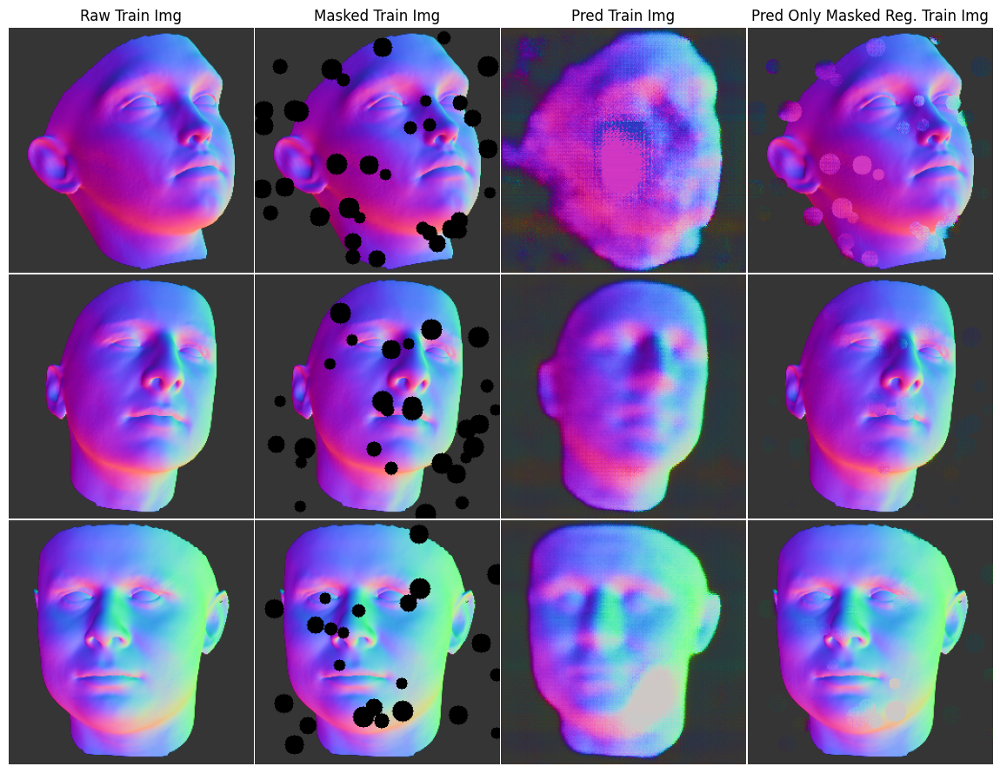

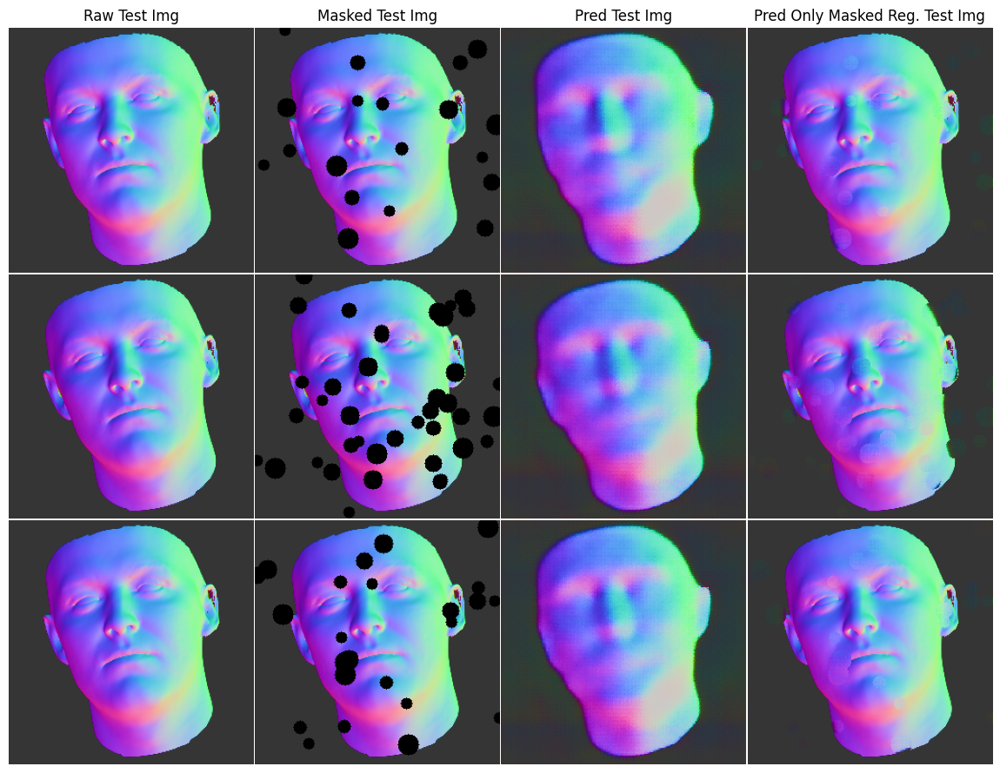

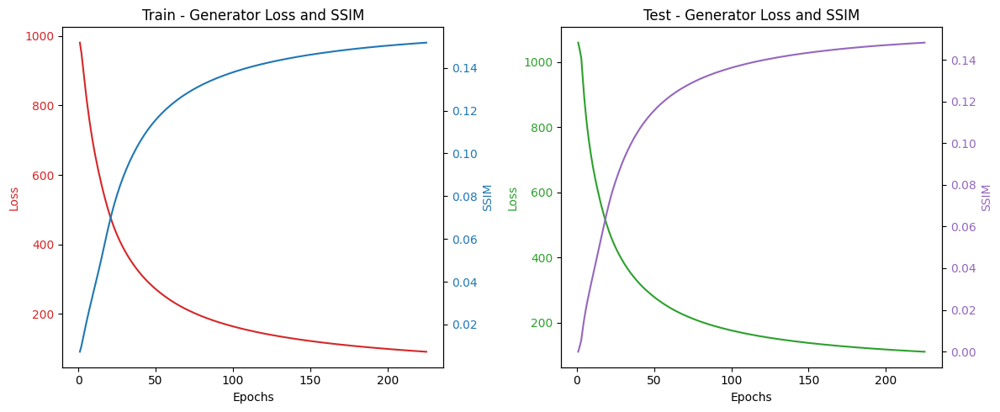

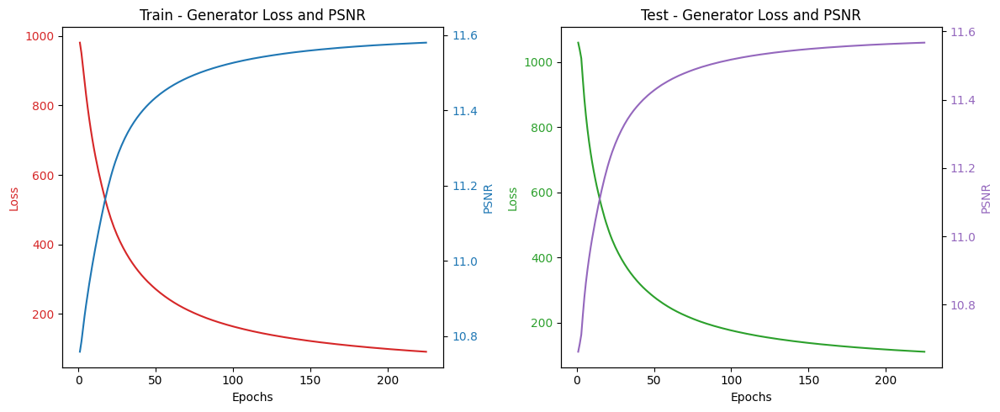

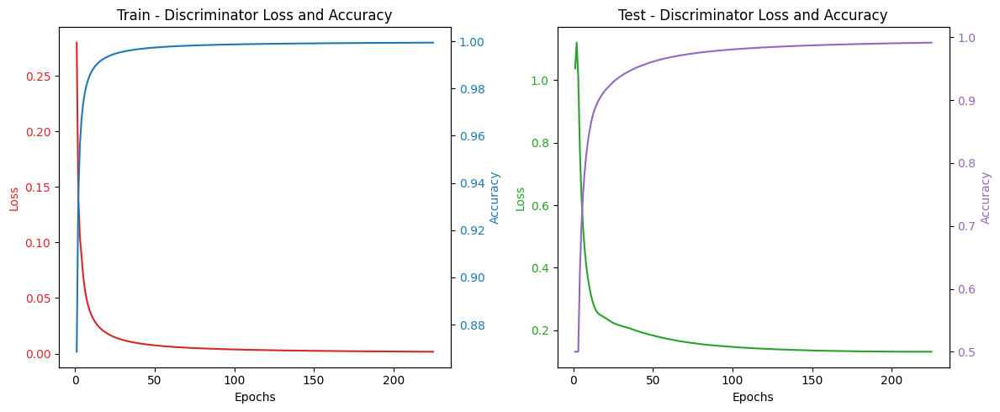

Epoch 226/1000  Train[G_Loss:26.43678 SSIM:16.28% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.10256 SSIM:15.75% PSNR:11.60 Disc:0.12802 100.000%] - 3s  
Epoch 227/1000  Train[G_Loss:25.73308 SSIM:16.29% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.47194 SSIM:15.74% PSNR:11.60 Disc:0.13003 100.000%] - 4s  
Epoch 228/1000  Train[G_Loss:25.68415 SSIM:16.29% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.21731 SSIM:15.77% PSNR:11.60 Disc:0.13556 100.000%] - 3s  
Epoch 229/1000  Train[G_Loss:25.64138 SSIM:16.28% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.65715 SSIM:15.73% PSNR:11.60 Disc:0.13777 100.000%] - 4s  
Epoch 230/1000  Train[G_Loss:25.32893 SSIM:16.27% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.96494 SSIM:15.71% PSNR:11.60 Disc:0.13106 100.000%] - 3s  
Epoch 231/1000  Train[G_Loss:25.28695 SSIM:16.28% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.12499 SSIM:15.74% PSNR:11.60 Disc:0.13145 100.000%] - 3s  
Epoch 232/1000  Train[G_Loss:24.72868 SSIM:16.

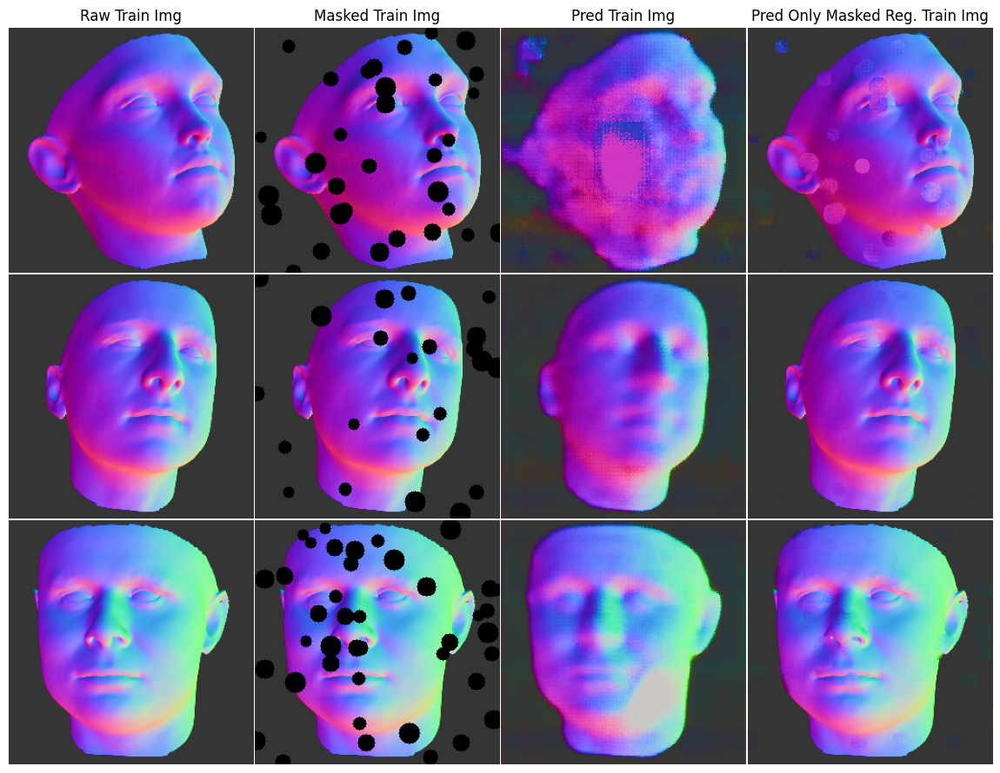

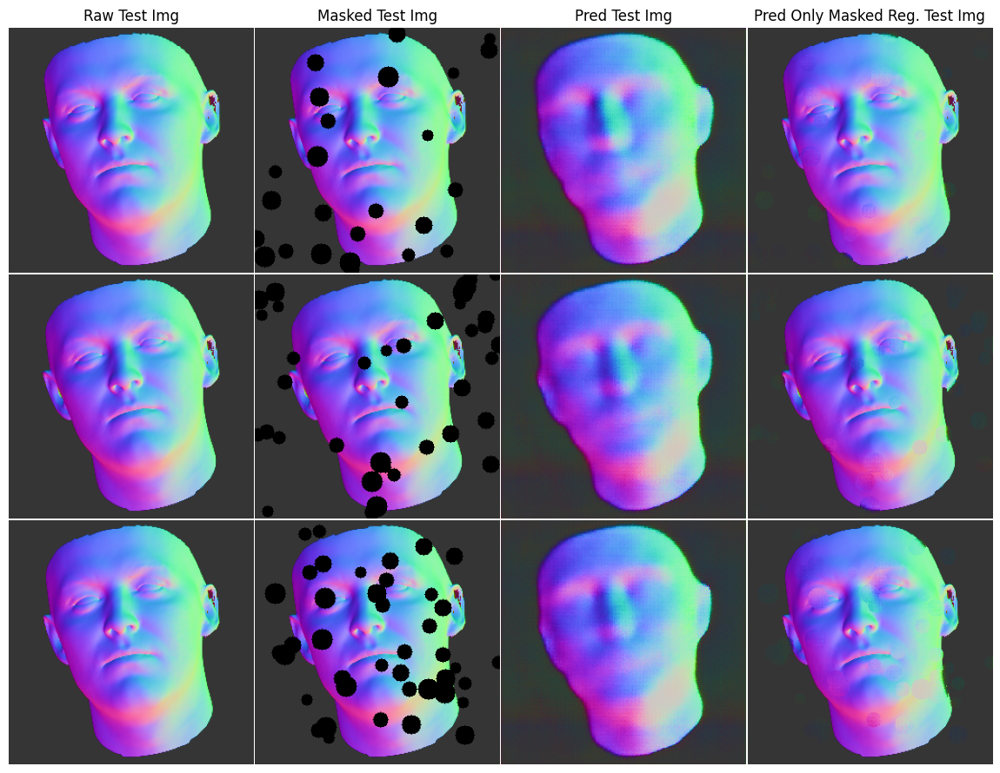

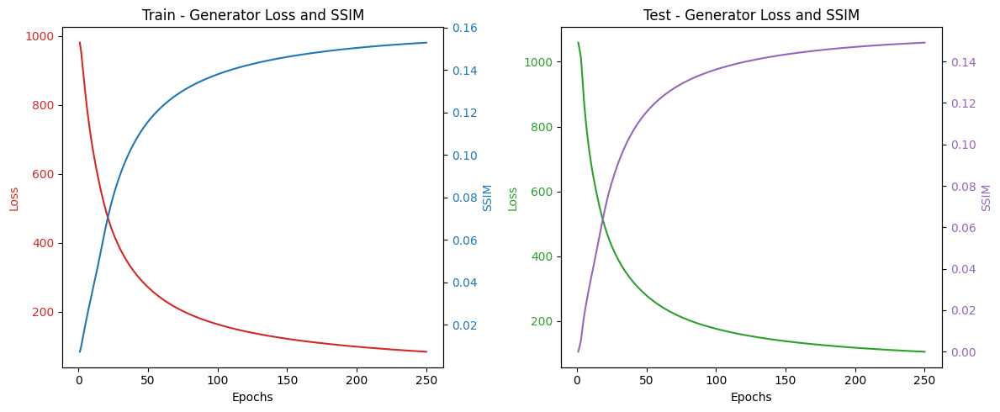

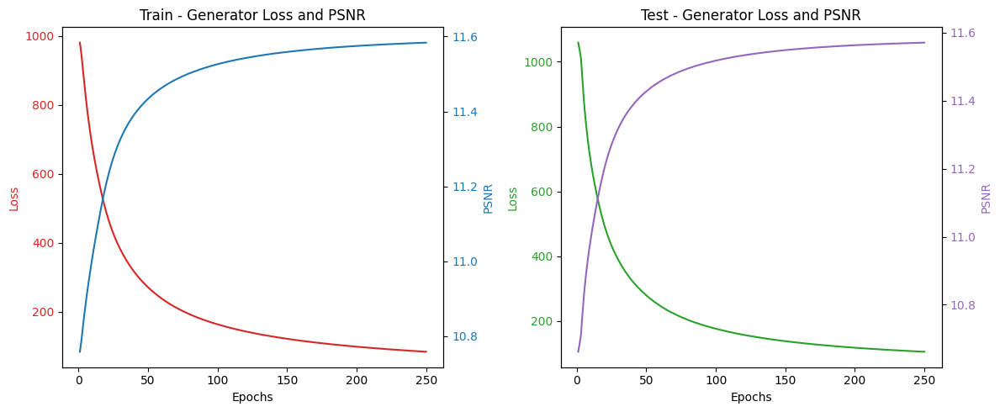

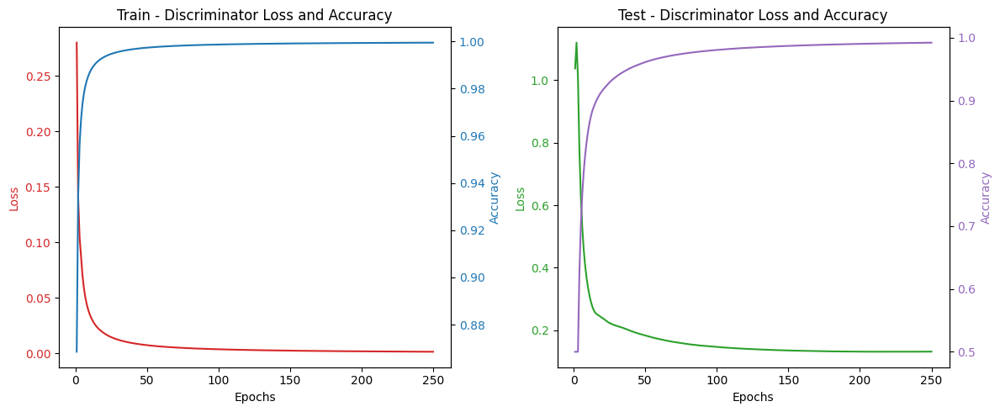

Epoch 251/1000  Train[G_Loss:23.81005 SSIM:16.23% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.41983 SSIM:15.70% PSNR:11.60 Disc:0.14502 100.000%] - 3s  
Epoch 252/1000  Train[G_Loss:23.62751 SSIM:16.23% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:56.22720 SSIM:15.68% PSNR:11.60 Disc:0.14470 100.000%] - 3s  
Epoch 253/1000  Train[G_Loss:23.84841 SSIM:16.22% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.11650 SSIM:15.66% PSNR:11.60 Disc:0.13570 100.000%] - 3s  
Epoch 254/1000  Train[G_Loss:23.66055 SSIM:16.24% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.59702 SSIM:15.67% PSNR:11.60 Disc:0.13845 100.000%] - 3s  
Epoch 255/1000  Train[G_Loss:23.55806 SSIM:16.24% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.64300 SSIM:15.70% PSNR:11.60 Disc:0.14735 100.000%] - 3s  
Epoch 256/1000  Train[G_Loss:23.55837 SSIM:16.23% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.39039 SSIM:15.71% PSNR:11.60 Disc:0.14650 100.000%] - 3s  
Epoch 257/1000  Train[G_Loss:23.31844 SSIM:16.

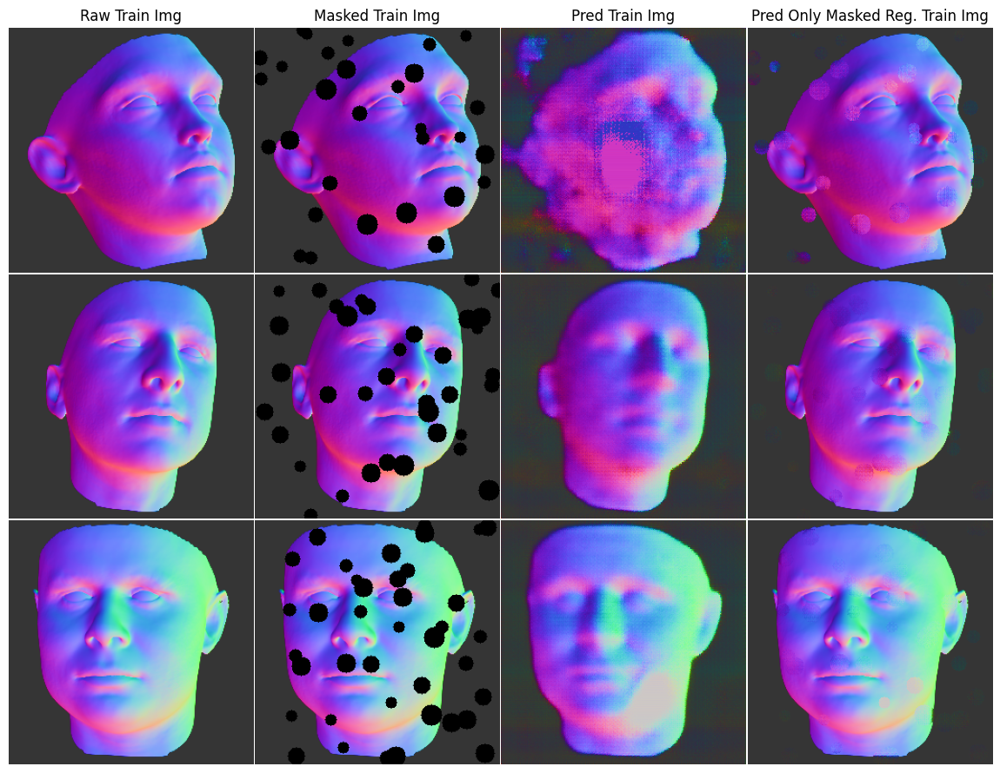

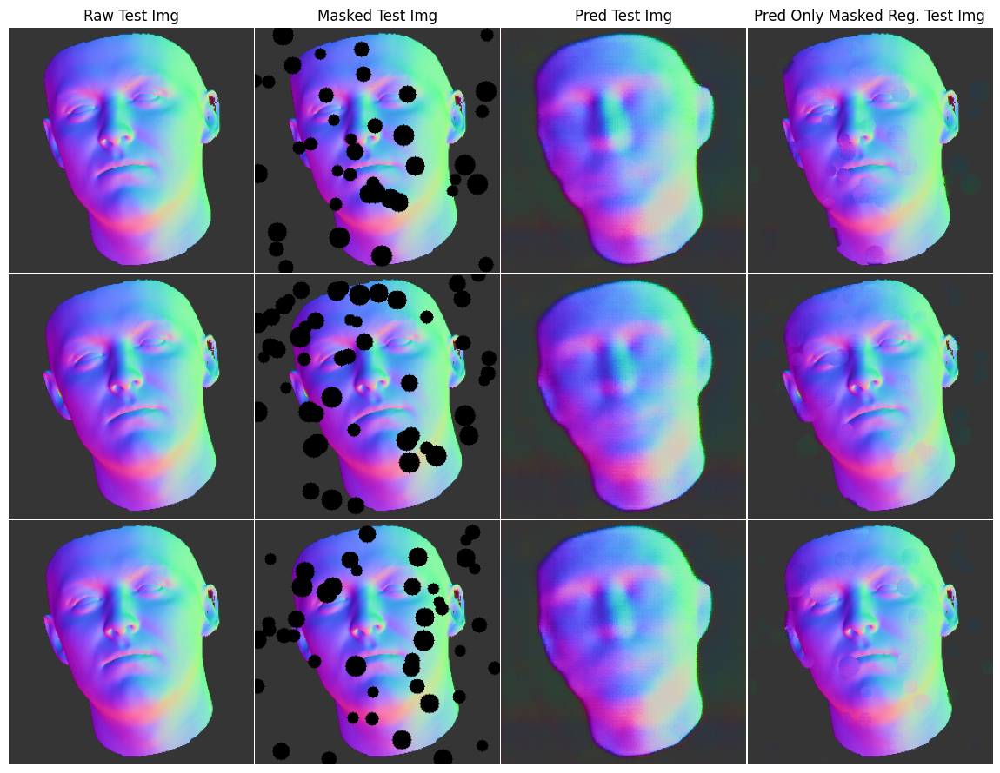

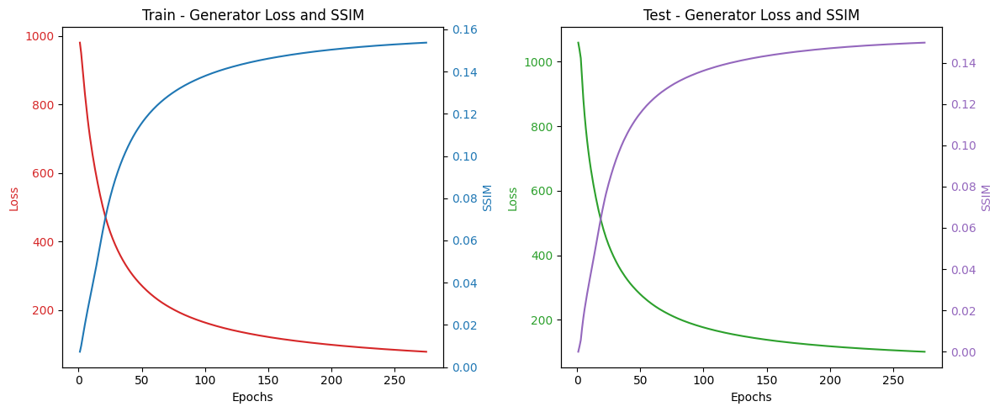

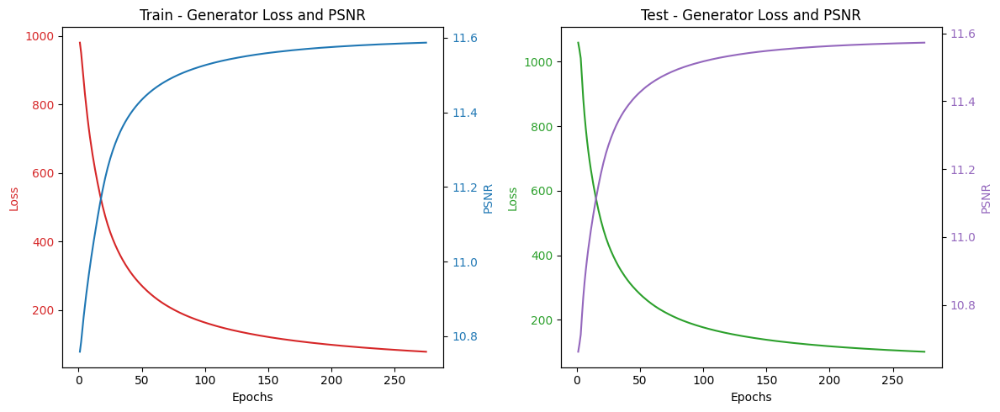

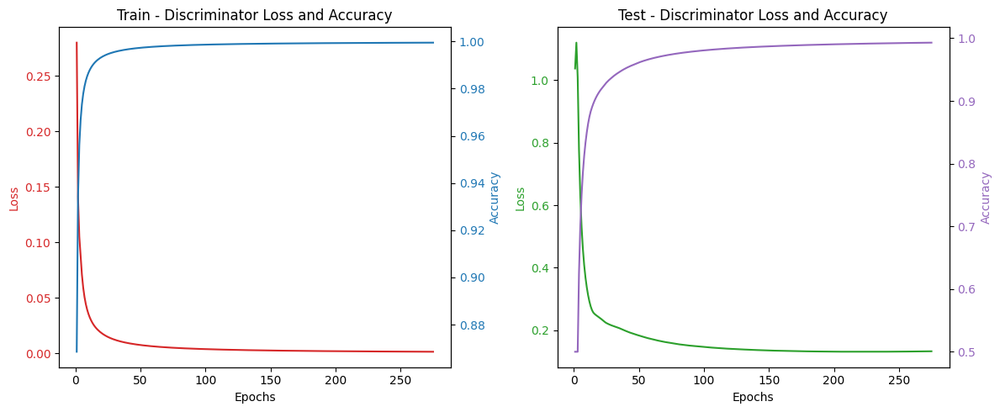

Epoch 276/1000  Train[G_Loss:22.89668 SSIM:16.20% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.31700 SSIM:15.68% PSNR:11.60 Disc:0.15035 100.000%] - 3s  
Epoch 277/1000  Train[G_Loss:22.61272 SSIM:16.20% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.44497 SSIM:15.62% PSNR:11.60 Disc:0.15282 100.000%] - 3s  
Epoch 278/1000  Train[G_Loss:22.72008 SSIM:16.19% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.85156 SSIM:15.59% PSNR:11.60 Disc:0.14792 100.000%] - 3s  
Epoch 279/1000  Train[G_Loss:22.66250 SSIM:16.20% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.24162 SSIM:15.63% PSNR:11.60 Disc:0.14665 100.000%] - 3s  
Epoch 280/1000  Train[G_Loss:22.16450 SSIM:16.21% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.26365 SSIM:15.69% PSNR:11.60 Disc:0.15329 100.000%] - 3s  
Epoch 281/1000  Train[G_Loss:22.42938 SSIM:16.19% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:55.06851 SSIM:15.63% PSNR:11.60 Disc:0.15308 100.000%] - 3s  
Epoch 282/1000  Train[G_Loss:21.85939 SSIM:16.

In [44]:
train(train_dataset, test_dataset, max_epochs=1000, epoch_break=25, batches_list_num=15, generator=generator, discriminator=discriminator)

# Testing and Evaluation on Test Dataset

### Load trained generator

In [44]:
gen_model_pth = './saved_model/generator_best.h5'
if os.path.exists(gen_model_pth):
    print('Load generator model')
    generator = tf.keras.models.load_model(gen_model_pth, custom_objects={'UnitNormalize': UnitNormalize})
    
dis_model_pth = './saved_model/discriminator_best.h5'
if os.path.exists(dis_model_pth):
    print('Load discriminator model')
    discriminator = tf.keras.models.load_model(dis_model_pth, compile=False)

Load generator model
Load discriminator model


### Generate Irregular Mask (batch size) （generate fixed masking lines for testing）

In [45]:
def mask_irregular(batch_size, mask_width, mask_height, seed=8):
    random.seed(seed)
    np.random.seed(seed)
    
    size = int(round((mask_width + mask_height) * 0.03))
    mask = np.zeros((batch_size, mask_width, mask_height, 1))
    
    # Generate mask properties outside the batch loop so all masks in the batch are the same
    num_blobs = np.random.randint(20, 50)
    blobs = []
    for _ in range(num_blobs):
        blob_size = np.random.randint(min(mask_width, mask_height) // 40, min(mask_width, mask_height) // 20)
        x = np.random.randint(0, mask_width)
        y = np.random.randint(0, mask_height)
        blobs.append((x, y, blob_size))

    # Apply the same mask properties to each image in the batch
    for i in range(batch_size):
        for x, y, blob_size in blobs:
            cv2.circle(mask[i], (x, y), blob_size, (1, 1, 1), -1)

    return np.float32(((1 - mask) * 2) - 1)  # [-1, 1]

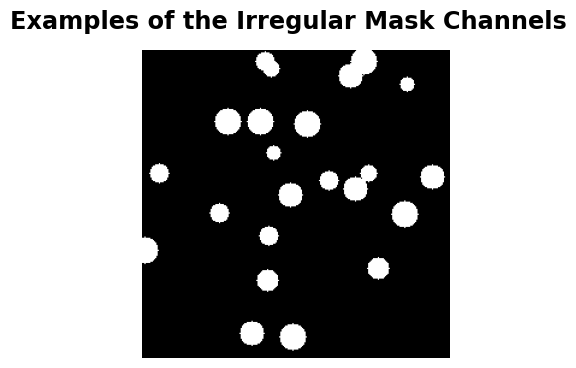

In [46]:
irregular_mask_examples = mask_irregular(6, 256, 256)
for ax, img in zip(ImageGrid(plt.figure(figsize=(6, 4)), 111, nrows_ncols=(1, 1), axes_pad=0.3), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.show()

### Evaluate the function for the dataset

In [47]:
def generator_cosine_similarity_loss(real_images, generated_images):
    # Cosine similarity is maximized, so we negate the value to minimize loss
    return cosine_loss(real_images, generated_images)

In [48]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_cosine_similarity_loss(raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

In [49]:
test_metrics = assessment(test_dataset)

print("Test dataset Avg LOSS: {:.4f}\n"
      "Test dataset Avg SSIM: {:.4f}\n"
      "Test dataset Avg PSNR: {:.4f}\n"
      "Test dataset Disc Avg Loss: {:.4f}\n"
      "Test dataset Disc Avg ACC: {:.2f}%".format(test_metrics['gen_loss'], 
                                                  test_metrics['gen_ssim'], 
                                                  test_metrics['gen_psnr'], 
                                                  test_metrics['disc_loss'], 
                                                  test_metrics['disc_acc'] * 100))

Test dataset Avg LOSS: -0.9481
Test dataset Avg SSIM: 0.1567
Test dataset Avg PSNR: 11.5988
Test dataset Disc Avg Loss: 0.1427
Test dataset Disc Avg ACC: 100.00%


In [50]:
print('Pred time for a batch')
for images_batch in test_dataset.take(1):
    test_raw_images = images_batch
    test_mask_channels = mask_irregular(test_raw_images.shape[0], test_raw_images.shape[1], test_raw_images.shape[2])
    test_masked_images = masked_imgs(test_raw_images, test_mask_channels)
    test_pred_images = generator.predict([test_masked_images, test_mask_channels], batch_size=BATCH_SIZE)

Pred time for a batch
1/1 [==============================] - 0s 236ms/step


### Plot Function

In [51]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False, dpi=300):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3), dpi=dpi), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path, dpi=dpi)     
    plt.show()

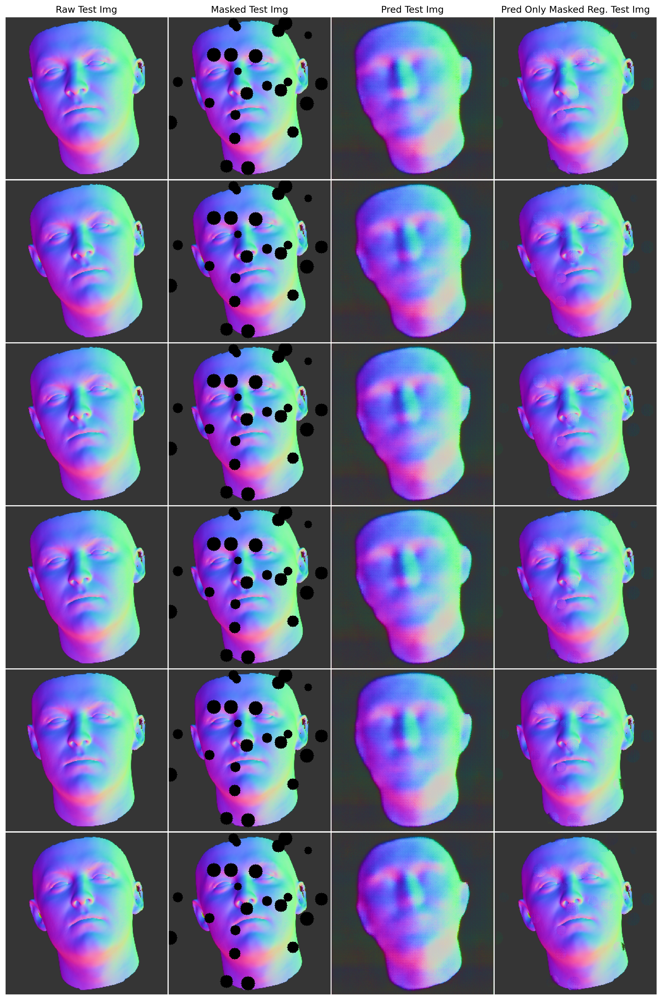

In [52]:
generator_plot_images(generator, 'Test', test_dataset, num = 6, epoch='final', save_images=True)

### Reading and plotting data from log data file

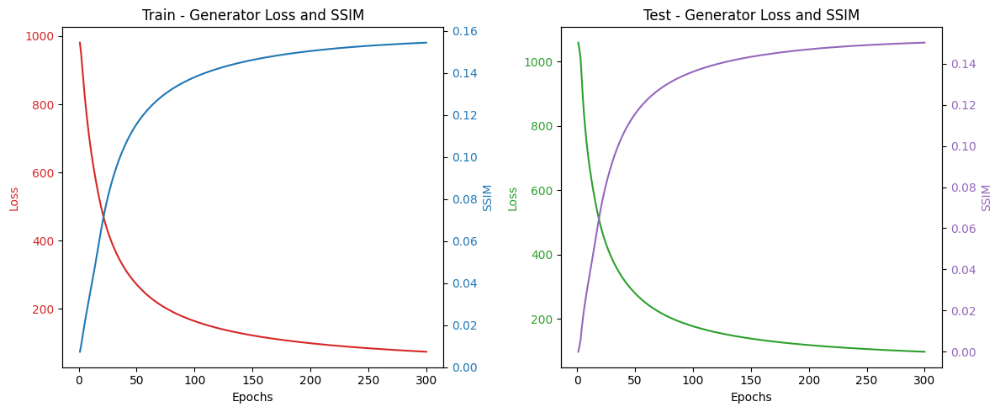

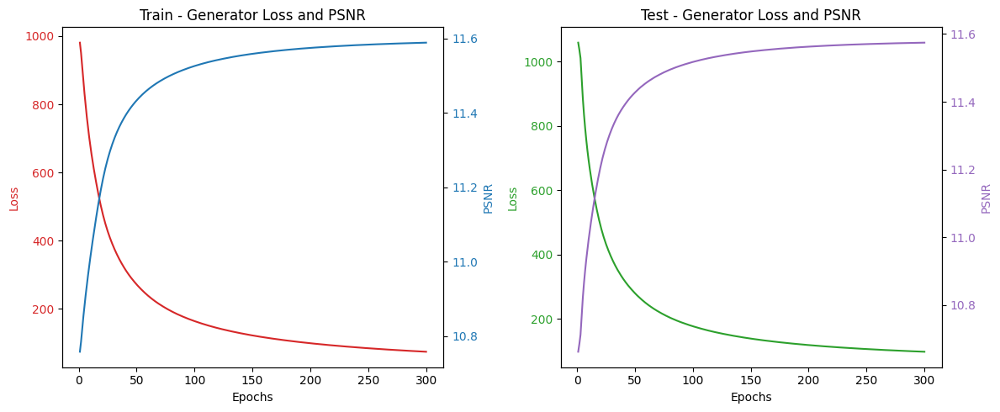

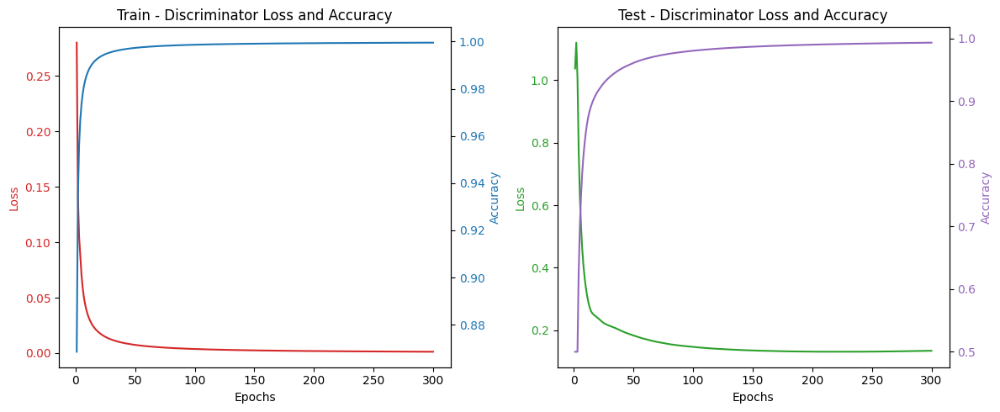

In [53]:
log_dir = './saved_logs'
os.makedirs(log_dir, exist_ok=True)
log_file = os.path.join(log_dir, "GAN_training_results.csv")
plot_metrics(load_metrics_from_csv(log_file))